# Код model

# 1. Код model

## 1.1 Импорт библиотек

In [1]:
"""
Full definition of a GPT Language Model, all of it in this single file.
References:
1) the official GPT-2 TensorFlow implementation released by OpenAI:
https://github.com/openai/gpt-2/blob/master/src/model.py
2) huggingface/transformers PyTorch implementation:
https://github.com/huggingface/transformers/blob/main/src/transformers/models/gpt2/modeling_gpt2.py
"""

import time as tm
t1_itogo = tm.time()
t1_temp = tm.time()

import math
import inspect
from dataclasses import dataclass

import torch
import torch.nn as nn
from torch.nn import functional as F

import transformers

import matplotlib.pyplot as plt
import numpy as np  # for normalization

In [2]:

"""
Sample from a trained model
"""
import os
import pickle
from contextlib import nullcontext
import tiktoken

t2_temp = tm.time()
print('импорт библиотек занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

импорт библиотек занял 0 минут 12 секунд


## 1.2 Основные классы и функции

In [3]:
t1_temp = tm.time()

# def normalize_image(im):   прошлая версия функции normalize_image, ChatGPT предложил другую (см. ниже) 
                             #Чтобы исключить ошибки при операцией над скалирным массивом или числом 
#    im_res = im - np.min(im)
#    return (1 / np.max(im_res)) * im_res

def normalize_image(im: np.ndarray) -> np.ndarray:
    """Normalize array to [0,1] using min-max. Safe for constant arrays."""
    im = np.asarray(im)
    im_res = im - np.min(im)
    maxv = np.max(im_res)
    if maxv == 0:
        return np.zeros_like(im_res)
    return (1.0 / maxv) * im_res

In [4]:
class LayerNorm(nn.Module):
    """ LayerNorm but with an optional bias. PyTorch doesn't support simply bias=False """

    def __init__(self, ndim, bias):
        super().__init__()
        self.weight = nn.Parameter(torch.ones(ndim))  # LayerNorm объект класса nn.Module и мы тут явно задаем nn.Parameter
        self.bias = nn.Parameter(torch.zeros(ndim)) if bias else None # self.bias - 2это вектор смещений

    def forward(self, input):
        return F.layer_norm(input, self.weight.shape, self.weight, self.bias, 1e-5)

In [5]:
class CausalSelfAttention(nn.Module):# ме не задаем тут nn.Parameters, потому что они есть во вложенных слоях класса nn.Linear

    def __init__(self, config): #сonfig - что получили снаружи
        super().__init__()
        assert config.n_embd % config.n_head == 0 # а этот кусок что делает???
        # key, query, value projections for all heads, but in a batch
        self.c_attn = nn.Linear(config.n_embd, 3 * config.n_embd, bias=config.bias) #класс CausalSelfAttention содержит класс  self.c_attn
                                                                                     # раз тут есть слой класса nn.Linear 
                                                                                # то в нем уже есть "место" для атрибута nn.Parameter
                                                       #  self.c_attn у нас тот самый линейный слой, который превращает 
                                                     #входной промпт x = тензор размера BxTxC преобразуется в тензор размера BxTx3C
                                                     # то есть self.c_attn создает тензор размера BxTx3C
                                                    
                               # то есть этот слой занимается линейным преобразованием тензора промпта 
                               # при этом увеличивает его размерность
                                           # что из него мы потом сможем вырезаем Q, K и V, чтобы считать Attention 
        self.c_proj = nn.Linear(config.n_embd, config.n_embd, bias=config.bias)   
                                        # c_proj обсуждаем вот здесь https://chatgpt.com/share/68f252f7-2460-8000-9461-0c92bdbb4dbb
                                        # но пока не понятно
                                                                             
        self.attn_dropout = nn.Dropout(config.dropout) # nn.Dropout специальный слой регуляризации в нейросетях, 
                                                    # который помогает модели не переобучаться.
                                                    # как работает, пока не важно
        self.resid_dropout = nn.Dropout(config.dropout) # Dropout  еще где-то работает. Пока не важно
        self.n_head = config.n_head # количество голов берем из config
        self.n_embd = config.n_embd # тут просто задается, что длина вектора  эмбеддинга (эмбеддинг = эмбеддинг токена) такая, 
                                    #  как задано в какой-то штуке config, которая подается на вход CausalSelfAttention
                                    # и с которой мы разберемся потом
        self.dropout = config.dropout # будем ли делать Dropout, берем из config
        
        # flash attention make GPU go brrrrr but support is only in PyTorch >= 2.0
        self.flash = hasattr(torch.nn.functional, 'scaled_dot_product_attention') # тут проверяется наличие функции 
                                                       # torch.nn.functional.scaled_dot_product_attention
                                                       # если она есть, то self.flash = True 
                                                      # и мы считаем Attention в forward через torch.nn.functional.scaled_dot_product_attention
                                                      # если этой функции нет - считаем Attention напрямую по формулам (см. def forward ... else...)
        if not self.flash:
            print("WARNING: using slow attention. Flash Attention requires PyTorch >= 2.0")
            # causal mask to ensure that attention is only applied to the left in the input sequence
            self.register_buffer("bias", torch.tril(torch.ones(config.block_size, config.block_size)) 
                                        .view(1, 1, config.block_size, config.block_size))
            # register_buffer(name, tensor) — это метод базового класса nn.Module
            # он сохраняет тензор как часть состояния модели  и дает ему имя name
            # но это константа, он не учится. То есть он не входит в nn.Parameters, которые всегда обучаются
            # torch.ones(config.block_size, config.block_size) создает квадратную катрицу единиц
            # torch.tril(...) оставляет от этой матрицы только нижний треугольник, обнуляет все, что выше диагонали. 
            # .view(1, 1, block_size, block_size) добавляет фиктивныке измерения, 
            # то есть .view(1, 1, block_size, block_size) делает из матрицы (block_size, block_size)
            # матрицу (1, 1, block_size, block_size) 
            # и ее можно потом применять ко всем батчам batch и головам внимания (head) 
            # то есть self.register_buffer ( или self.bias???) и att будут иметь одинаковую размерность 

    def forward(self, x):
        B, T, C = x.size()  # batch size, sequence length, embedding dim
                            # тут рассчитываем размерность промпта = размерность тензора скрытых состояний токенов.
                            #  первый раз туда попадает начальное скрытой состояние tok_emb + pos_emb
                            # а потом уже скрытые состояния токенов, которые вышли из прошлого блока Block
                            #B = batch size = количество батчей. Для обученния (где model тоже используется), их обычно несколько
                            # чтобы учиться одновременно на разных промптах
                             
        q, k, v = self.c_attn(x).split(self.n_embd, dim=2)  # тут у нас две операции (то есть сложная функция)
                                                            # сначала self.c_attn беред на вход тенезор размера BxTxC 
                                                             # и преобразует его в тензор BxTx3C
                                                             # а потом методод сплит режет его по второй оси, где у нас как раз 3C  
                                                             # на вектора длины C, то есть self.n_embd, которые мы получили из config
         
        k = k.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)  #тут происхордит "деление на головы"
                                                                 # когда длина эмбеддинга токена (она же ширина модели, она же hidden size
                                                        # раскраивается-разрезается на количество голов , то есть на число self.head)
                               # после разбиения каждый из тензоров q, k и v становится 4-мерным тензором формы (B, n_head, T, head_dim)
                                    # где  , как и раньше B - размер баптча, а  T - длина последовательности токенов
                            # но теперь вместо одного измерения C (=длина эмбеддинга) 
                             # возникает количество голов n_head и порция признаков на одну голову C // n_head
                             # все это количество голов, как и B, T и С берется из config
        
        q = q.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)
        v = v.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)

    # ⬅️ Добавим это
        self.last_k = k.detach().to(torch.float16).cpu()
        self.last_q = q.detach().to(torch.float16).cpu()
        self.last_v = v.detach().to(torch.float16).cpu()

        if self.flash: # готовая функция для Attention - формул внизу, которые идет после else
                       # если в версии PyTorch уже есть эта готовая функция - используем ее, если нет, то считаем "вручную" по формулам ниже
            y = torch.nn.functional.scaled_dot_product_attention(
            q, k, v, attn_mask=None,
            dropout_p=self.dropout if self.training else 0,
            is_causal=True)
        else: # если нет готовой функции torch.nn.functional.scaled_dot_product_attention, 
            # то ниже прямой расчет внимания через прямые формулы
            att = (q @ k.transpose(-2, -1)) * (1.0 / math.sqrt(k.size(-1))) # Это сырые логиты внимания,
                                                                              # насколько каждый токен t_query «похож» на каждый токен t_key.
            att = att.masked_fill(self.bias[:, :, :T, :T] == 0, float('-inf')) # для верхнетреугольной части (будущее") логиты заменяются на -inf
                                                                                # после softmax это превратится в 0 и это "запрет загабывать вперед"
                                                            # то есть каждый токен смотрит только не предыдущие токены, а на те, что после него - нет
            att = F.softmax(att, dim=-1) # перевод значания в вероятность
            att = self.attn_dropout(att) # в режиме обучение зануление части вероятностей для профилавктики переобучения.
                                         # Как работает, пока не знаю
            y = att @ v   #а что за y мы получили???

        y = y.transpose(1, 2).contiguous().view(B, T, C)   # Склеиваем головыn внимания обратно: (B, H, T, Dh) → (B, T, H*Dh=C)
                                                         # что за размерность Dh??? Зачем нужны головы внимания?  
        y = self.resid_dropout(self.c_proj(y))
        return y


t2_temp = tm.time()
print('этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

этот блок занял 0 минут 0 секунд


In [6]:
def plot_weight_matrices(
    attn,
    transpose: bool = True,
    show_qkv: bool = True,
    cmap: str = "coolwarm",
    normalize: bool = True,
):
    """
    Визуализирует матрицы весов внимания слоя: c_attn и c_proj с помощью plt.imshow.

    Параметры:
    - attn: объект CausalSelfAttention (или совместимый), у которого есть:
        .c_attn, .c_proj, .n_embd, .n_head
    - transpose:
        True  -> приводим к «математическому» виду:
                 c_attn: (C, 3C), c_proj: (C, C)
        False -> оставляем PyTorch-формат:
                 c_attn: (3C, C), c_proj: (C, C)
    - show_qkv:
        True  -> режем c_attn на W_q, W_k, W_v и показываем все три + c_proj
        False -> показываем c_attn целиком (concat Q|K|V) + c_proj
    - cmap: палитра для imshow
    - normalize:
        True  -> прогоняем через normalize_image(...) и ставим vmin=0, vmax=1
        False -> общая симметричная шкала [-max_abs, max_abs]

    Возвращает:
    - fig, axes: фигура matplotlib и массив осей.
    """
    import torch
    import numpy as np
    import matplotlib.pyplot as plt

    with torch.no_grad():
        # ----- 1. Берём веса из c_attn -----
        # В PyTorch у Linear: weight.shape = (out_features, in_features)
        # Для c_attn out=3C, in=C
        W_cat = attn.c_attn.weight.detach().cpu()  # (3C, C)
        if transpose:
            W_cat = W_cat.T                         # (C, 3C) "математический" вид

        C = attn.n_embd

        # Режем на W_q, W_k, W_v по последнему измерению (если transpose=True — по столбцам)
        if show_qkv:
            if transpose:
                # (C, 3C) -> три блока по последней оси
                W_q = W_cat[:, :C]
                W_k = W_cat[:, C:2*C]
                W_v = W_cat[:, 2*C:]
            else:
                # (3C, C) -> три блока по первой оси
                W_q = W_cat[:C, :]
                W_k = W_cat[C:2*C, :]
                W_v = W_cat[2*C:, :]
        else:
            W_q = W_k = W_v = None  # не будем использовать, просто заглушки

        # ----- 2. Берём веса из c_proj -----
        # Для c_proj out=C, in=C
        W_proj = attn.c_proj.weight.detach().cpu()  # (C, C)
        if transpose:
            W_proj = W_proj.T                        # хотим (C, C), но это и так, просто на всякий

        # ----- 3. Настраиваем масштаб (vmin, vmax) -----
        mats = [W_cat, W_proj] + ([W_q, W_k, W_v] if (show_qkv and W_q is not None) else [])

        if normalize:
            # normalize_image у тебя уже определена выше в файле
            W_proj = normalize_image(W_proj)
            if show_qkv and W_q is not None:
                W_q = normalize_image(W_q)
                W_k = normalize_image(W_k)
                W_v = normalize_image(W_v)
            else:
                W_cat = normalize_image(W_cat)
            vmin, vmax = 0.0, 1.0
        else:
            vmax = max(float(np.abs(m).max()) for m in mats if m is not None)
            vmin = -vmax

        # ----- 4. Рисуем -----
        if show_qkv and W_q is not None:
            # c_proj + W_q + W_k + W_v (4 картинки в ряд)
            fig, axes = plt.subplots(1, 4, figsize=(18, 4))
            ims = []

            im = axes[0].imshow(W_proj, aspect='auto', interpolation='nearest',
                                cmap=cmap, vmin=vmin, vmax=vmax)
            axes[0].set_title('c_proj weight')
            ims.append(im)

            im = axes[1].imshow(W_q, aspect='auto', interpolation='nearest',
                                cmap=cmap, vmin=vmin, vmax=vmax)
            axes[1].set_title('c_attn: W_q')
            ims.append(im)

            im = axes[2].imshow(W_k, aspect='auto', interpolation='nearest',
                                cmap=cmap, vmin=vmin, vmax=vmax)
            axes[2].set_title('c_attn: W_k')
            ims.append(im)

            im = axes[3].imshow(W_v, aspect='auto', interpolation='nearest',
                                cmap=cmap, vmin=vmin, vmax=vmax)
            axes[3].set_title('c_attn: W_v')
            ims.append(im)

            for ax in axes:
                ax.set_xlabel('in features')
                ax.set_ylabel('out features')

            # общая цветовая шкала
            fig.colorbar(ims[0], ax=axes, fraction=0.02)

        else:
            # Показываем только c_proj и c_attn целиком (concat Q|K|V)
            fig, axes = plt.subplots(1, 2, figsize=(10, 4))

            im0 = axes[0].imshow(W_proj, aspect='auto', interpolation='nearest',
                                 cmap=cmap, vmin=vmin, vmax=vmax)
            axes[0].set_title('c_proj weight')

            im1 = axes[1].imshow(W_cat, aspect='auto', interpolation='nearest',
                                 cmap=cmap, vmin=vmin, vmax=vmax)
            axes[1].set_title('c_attn (concat Q|K|V)')

            for ax in axes:
                ax.set_xlabel('in features')
                ax.set_ylabel('out features')

            fig.colorbar(im0, ax=axes, fraction=0.02)

    return fig, axes


In [7]:
class MLP(nn.Module):

    def __init__(self, config):
        super().__init__()
        self.c_fc    = nn.Linear(config.n_embd, 4 * config.n_embd, bias=config.bias)
        self.gelu    = nn.GELU()
        self.c_proj  = nn.Linear(4 * config.n_embd, config.n_embd, bias=config.bias)
        self.dropout = nn.Dropout(config.dropout)

    def forward(self, x):
        x = self.c_fc(x)
        x = self.gelu(x)
        x = self.c_proj(x)
        x = self.dropout(x)
        return x

In [8]:
# 3) BLOCK с параметром attn_cls
class Block(nn.Module):

    def __init__(self, config, attn_cls=CausalSelfAttention):
        super().__init__()
        self.ln_1 = LayerNorm(config.n_embd, bias=config.bias)
        self.attn = attn_cls(config)
        self.ln_2 = LayerNorm(config.n_embd, bias=config.bias)
        self.mlp = MLP(config)

    def forward(self, x):
        x = x + self.attn(self.ln_1(x))
        x = x + self.mlp(self.ln_2(x))
        return x


In [9]:
@dataclass
class GPTConfig:
    block_size: int = 1024
    vocab_size: int = 50304 # GPT-2 vocab_size of 50257, padded up to nearest multiple of 64 for efficiency
    n_layer: int = 12
    n_head: int = 12
    n_embd: int = 768
    dropout: float = 0.0
    bias: bool = True # True: bias in Linears and LayerNorms, like GPT-2. False: a bit better and faster


In [10]:
class GPT(nn.Module):

    def __init__(self, config, attn_cls=CausalSelfAttention):
        super().__init__()
        assert config.vocab_size is not None
        assert config.block_size is not None
        self.config = config

        self.transformer = nn.ModuleDict(dict(
            wte = nn.Embedding(config.vocab_size, config.n_embd),
            wpe = nn.Embedding(config.block_size, config.n_embd),
            drop = nn.Dropout(config.dropout),
            h = nn.ModuleList([Block(config, attn_cls=attn_cls) for _ in range(config.n_layer)]),
            ln_f = LayerNorm(config.n_embd, bias=config.bias),
        ))
        self.lm_head = nn.Linear(config.n_embd, config.vocab_size, bias=False)
        # with weight tying when using torch.compile() some warnings get generated:
        # "UserWarning: functional_call was passed multiple values for tied weights.
        # This behavior is deprecated and will be an error in future versions"
        # not 100% sure what this is, so far seems to be harmless. TODO investigate
        self.transformer.wte.weight = self.lm_head.weight # https://paperswithcode.com/method/weight-tying

        # init all weights
        self.apply(self._init_weights)
        # apply special scaled init to the residual projections, per GPT-2 paper
        for pn, p in self.named_parameters():
            if pn.endswith('c_proj.weight'):
                torch.nn.init.normal_(p, mean=0.0, std=0.02/math.sqrt(2 * config.n_layer))

        # report number of parameters
        print("number of parameters: %.2fM" % (self.get_num_params()/1e6,))

    def get_num_params(self, non_embedding=True): # можно вынести, но он маленький, начинаем не с него 
        """
        Return the number of parameters in the model.
        For non-embedding count (default), the position embeddings get subtracted.
        The token embeddings would too, except due to the parameter sharing these
        params are actually used as weights in the final layer, so we include them.
        """
        n_params = sum(p.numel() for p in self.parameters())
        if non_embedding:
            n_params -= self.transformer.wpe.weight.numel()
        return n_params

    def _init_weights(self, module):
        if isinstance(module, nn.Linear):
            torch.nn.init.normal_(module.weight, mean=0.0, std=0.02)
            if module.bias is not None:
                torch.nn.init.zeros_(module.bias)
        elif isinstance(module, nn.Embedding):
            torch.nn.init.normal_(module.weight, mean=0.0, std=0.02)

    def forward(self, idx, targets=None): # именно здесь у нас входной текст превращается в тензиор эмбеддингов BxTxC ,
                                          # который объединяет токенные и позиционные эмбеддинги
                                          # то есть является их суммой 
        
                                          # изначально idx - двухмерный тензор размера BxT
                                          # для каждого батча и токена он указывает номер токена в словаре
        device = idx.device
        b, t = idx.size()
        assert t <= self.config.block_size, f"Cannot forward sequence of length {t}, block size is only {self.config.block_size}"
        pos = torch.arange(0, t, dtype=torch.long, device=device) # shape (t)

        # forward the GPT model itself
        tok_emb = self.transformer.wte(idx) # token embeddings of shape (b, t, n_embd)
                   #self.transformer.wte - функция в подклассе self.tramsformer
                  # превращает индекс токенов idx в вектор токенных эмбеддингов
                    # размерность одного токена C = n_embd, размерность tok_emb =  BxTxC
                    #правильное название Batch of embeddings: (B, T, C)
                    # но используют и формулировку "токенный     эмбеддинг", имея в виду тип представления, а не конкретную форму
        pos_emb = self.transformer.wpe(pos) # position embeddings of shape (t, n_embd)
        x = self.transformer.drop(tok_emb + pos_emb)
        for block in self.transformer.h:
            x = block(x)
        x = self.transformer.ln_f(x)

        if targets is not None:
            # if we are given some desired targets also calculate the loss
            logits = self.lm_head(x)
            loss = F.cross_entropy(logits.view(-1, logits.size(-1)), targets.view(-1), ignore_index=-1)
        else:
            # inference-time mini-optimization: only forward the lm_head on the very last position
            logits = self.lm_head(x[:, [-1], :]) # note: using list [-1] to preserve the time dim
            loss = None

        return logits, loss

    def crop_block_size(self, block_size):
        # model surgery to decrease the block size if necessary
        # e.g. we may load the GPT2 pretrained model checkpoint (block size 1024)
        # but want to use a smaller block size for some smaller, simpler model
        assert block_size <= self.config.block_size
        self.config.block_size = block_size
        self.transformer.wpe.weight = nn.Parameter(self.transformer.wpe.weight[:block_size])
        for block in self.transformer.h:
            if hasattr(block.attn, 'bias'):
                block.attn.bias = block.attn.bias[:,:,:block_size,:block_size]

    @classmethod
    def from_pretrained(cls, model_type, override_args=None):
        # внешняя функция gpt_from_pretrained сама создаёт GPT(config),
        # поэтому cls здесь нам не нужен.
        return gpt_from_pretrained(model_type, override_args=override_args)

   #  def configure_optimizers(self, weight_decay, learning_rate, betas, device_type): вынесли вовне функция configure_optimizers
        
    def estimate_mfu(self, fwdbwd_per_iter, dt):
        """ estimate model flops utilization (MFU) in units of A100 bfloat16 peak FLOPS """
        # first estimate the number of flops we do per iteration.
        # see PaLM paper Appendix B as ref: https://arxiv.org/abs/2204.02311
        N = self.get_num_params()
        cfg = self.config
        L, H, Q, T = cfg.n_layer, cfg.n_head, cfg.n_embd//cfg.n_head, cfg.block_size
        flops_per_token = 6*N + 12*L*H*Q*T
        flops_per_fwdbwd = flops_per_token * T
        flops_per_iter = flops_per_fwdbwd * fwdbwd_per_iter
        # express our flops throughput as ratio of A100 bfloat16 peak flops
        flops_achieved = flops_per_iter * (1.0/dt) # per second
        flops_promised = 312e12 # A100 GPU bfloat16 peak flops is 312 TFLOPS
        mfu = flops_achieved / flops_promised
        return mfu

 #   @torch.no_grad() def generate #: вынесли вовне  функция generate

In [11]:
import inspect
import torch
from torch import nn

def configure_optimizers(
    model: nn.Module,
    weight_decay: float,
    learning_rate: float,
    betas=(0.9, 0.95),
    device_type: str = "cuda",
):
    """
    Создаёт AdamW-оптимизатор для модели, разделяя параметры на:
    - с weight decay (обычно матрицы весов, dim >= 2)
    - без weight decay (биасы, LayerNorm-ы и т.п., dim < 2)
    """

    # все trainable параметры
    param_dict = {pn: p for pn, p in model.named_parameters() if p.requires_grad}

    decay_params = []
    nodecay_params = []

    for pn, p in param_dict.items():
        if p.dim() >= 2:
            decay_params.append(p)     # матрицы
        else:
            nodecay_params.append(p)   # биасы, скаляры, LayerNorm.weight и т.п.

    optim_groups = [
        {"params": decay_params,   "weight_decay": weight_decay},
        {"params": nodecay_params, "weight_decay": 0.0},
    ]

    # fused AdamW, если доступен и если CUDA
    fused_available = "fused" in inspect.signature(torch.optim.AdamW).parameters
    use_fused = fused_available and device_type == "cuda"

    extra_args = {"fused": True} if use_fused else {}
    if use_fused:
        print("Using fused AdamW")
    else:
        print("Using standard AdamW")

    optimizer = torch.optim.AdamW(
        optim_groups, lr=learning_rate, betas=betas, **extra_args
    )
    return optimizer


In [12]:
import torch
from torch import nn

@torch.no_grad()
def generate(
    model: nn.Module,
    idx: torch.Tensor,
    max_new_tokens: int,
    temperature: float = 1.0,
    top_k: int | None = None,
):
    """
    Авто-регрессионная генерация токенов.

    Аргументы:
    - model: GPT-модель с атрибутом config.block_size
    - idx: (B, T) начальная последовательность токенов (LongTensor)
    - max_new_tokens: сколько новых токенов сгенерировать
    - temperature: >0, чем выше, тем более рандомно
    - top_k: если задано, обрезает распределение по top-k логитам

    Возвращает:
    - idx: (B, T + max_new_tokens)
    """
    for _ in range(max_new_tokens):
        # 1) обрезаем контекст до block_size
        block_size = model.config.block_size
        if idx.size(1) > block_size:
            idx_cond = idx[:, -block_size:]
        else:
            idx_cond = idx

        # 2) прогоняем модель
        logits, _ = model(idx_cond)   # логиты для всех позиций
        logits = logits[:, -1, :]     # берём только последний токен

        # 3) темпереатура
        if temperature != 1.0:
            logits = logits / temperature

        # 4) top-k фильтрация (опционально)
        if top_k is not None:
            v, _ = torch.topk(logits, top_k)
            v_min = v[:, -1, None]
            logits = torch.where(
                logits < v_min,
                torch.full_like(logits, float("-inf")),
                logits,
            )

        # 5) превращаем в вероятности и семплим следующий токен
        probs = torch.softmax(logits, dim=-1)   # (B, vocab_size)
        idx_next = torch.multinomial(probs, num_samples=1)  # (B, 1)

        # 6) дописываем в конец
        idx = torch.cat((idx, idx_next), dim=1)  # (B, T+1)

    return idx


In [13]:
@torch.no_grad()
def generate_with_q_history(
    model: nn.Module,
    idx: torch.Tensor,
    max_new_tokens: int,
    temperature: float = 1.0,
    top_k: int | None = None,
):
    """
    То же самое, что generate, но ДОПОЛНИТЕЛЬНО сохраняет last_q
    на каждом шаге генерации.

    Возвращает:
    - idx: (B, T + max_new_tokens) — итоговые токены
    - q_history: список длины max_new_tokens.
        q_history[step][layer_idx] имеет тип Tensor:
            shape = (n_head, T_step, head_dim)
        где T_step — длина контекста на данном шаге.
    """
    q_history: list[list[torch.Tensor | None]] = []

    for _ in range(max_new_tokens):
        # 1) обрезаем контекст до block_size
        block_size = model.config.block_size
        if idx.size(1) > block_size:
            idx_cond = idx[:, -block_size:]
        else:
            idx_cond = idx

        # 2) прогоняем модель
        logits, _ = model(idx_cond)   # логиты для всех позиций
        logits = logits[:, -1, :]     # берём только последний токен

        # 2a) Сохраняем last_q для каждого слоя после этого прогона
        step_q_layers: list[torch.Tensor | None] = []
        # предполагаем, что B = 1
        for block in model.transformer.h:
            attn = block.attn
            if getattr(attn, "last_q", None) is not None:
                # last_q: (B, n_head, T, head_dim)
                q = attn.last_q[0].detach().cpu().float().clone()  # (n_head, T, head_dim)
                step_q_layers.append(q)
            else:
                step_q_layers.append(None)
        q_history.append(step_q_layers)

        # 3) температура
        if temperature != 1.0:
            logits = logits / temperature

        # 4) top-k фильтрация (опционально)
        if top_k is not None:
            v, _ = torch.topk(logits, top_k)
            v_min = v[:, -1, None]
            logits = torch.where(
                logits < v_min,
                torch.full_like(logits, float("-inf")),
                logits,
            )

        # 5) превращаем в вероятности и семплим следующий токен
        probs = torch.softmax(logits, dim=-1)   # (B, vocab_size)
        idx_next = torch.multinomial(probs, num_samples=1)  # (B, 1)

        # 6) дописываем в конец
        idx = torch.cat((idx, idx_next), dim=1)  # (B, T+1)

    return idx, q_history


In [14]:
def gpt_from_pretrained(model_type: str, override_args=None):
    """
    Создаёт GPT(config) и загружает в него веса HuggingFace GPT‑2.
    Полный аналог старого GPT.from_pretrained.
    """
    import torch
    from transformers import GPT2LMHeadModel

    assert model_type in {'gpt2', 'gpt2-medium', 'gpt2-large', 'gpt2-xl'}
    override_args = override_args or {}

    # можно переопределять только dropout
    assert all(k == 'dropout' for k in override_args)

    print(f"loading weights from pretrained gpt: {model_type}")

    # ---- 1. Определяем конфиг по типу модели ----
    config_args = {
        'gpt2':         dict(n_layer=12, n_head=12, n_embd=768),
        'gpt2-medium':  dict(n_layer=24, n_head=16, n_embd=1024),
        'gpt2-large':   dict(n_layer=36, n_head=20, n_embd=1280),
        'gpt2-xl':      dict(n_layer=48, n_head=25, n_embd=1600),
    }[model_type]

    print("forcing vocab_size=50257, block_size=1024, bias=True")
    config_args['vocab_size'] = 50257
    config_args['block_size'] = 1024
    config_args['bias'] = True

    if 'dropout' in override_args:
        print(f"overriding dropout rate to {override_args['dropout']}")
        config_args['dropout'] = override_args['dropout']

    # ---- 2. Создаём нашу GPT-модель ----
    config = GPTConfig(**config_args)
    model = GPT(config)

    sd = model.state_dict()
    sd_keys = [k for k in sd.keys() if not k.endswith('.attn.bias')]

    # ---- 3. Грузим HuggingFace GPT‑2 ----
    model_hf = GPT2LMHeadModel.from_pretrained(model_type)
    sd_hf = model_hf.state_dict()

    sd_keys_hf = [k for k in sd_hf.keys()
                  if not k.endswith('.attn.masked_bias')
                  and not k.endswith('.attn.bias')]

    transposed = [
        'attn.c_attn.weight',
        'attn.c_proj.weight',
        'mlp.c_fc.weight',
        'mlp.c_proj.weight'
    ]

    assert len(sd_keys_hf) == len(sd_keys), \
        f"mismatched keys: {len(sd_keys_hf)} != {len(sd_keys)}"

    # ---- 4. Копируем веса с корректными транспонированиями ----
    for k in sd_keys_hf:
        if any(k.endswith(w) for w in transposed):
            assert sd_hf[k].shape[::-1] == sd[k].shape
            with torch.no_grad():
                sd[k].copy_(sd_hf[k].t())
        else:
            assert sd_hf[k].shape == sd[k].shape
            with torch.no_grad():
                sd[k].copy_(sd_hf[k])

    return model


In [15]:
import torch

cfg = GPTConfig(block_size=8, vocab_size=64, n_layer=2, n_head=2, n_embd=16, dropout=0.0, bias=True)
m = GPT(cfg).eval()

x = torch.randint(0, cfg.vocab_size, (1, 8))
with torch.no_grad():
    logits, loss = m(x, x)

print("OK:", logits.shape, "loss:", float(loss))


number of parameters: 0.01M
OK: torch.Size([1, 8, 64]) loss: 3.9659712314605713


### 1.2.1 Все функции рисования

In [16]:
def show_attn_weight_matrices(
    model: GPT, layer_idx: int, transpose: bool = True, show_qkv: bool = True, cmap: str = "coolwarm", normalize: bool = True):
    """
    Удобная обёртка: показываем weight-матрицы внимания (c_attn и c_proj) для блока с индексом layer_idx.
    Пример использования:
        fig, axes = show_attn_weight_matrices(model, layer_idx=0)
        plt.show()
    """
    attn = model.transformer.h[layer_idx].attn
    return plot_weight_matrices(attn, transpose=transpose, show_qkv=show_qkv, cmap=cmap, normalize=normalize)

In [17]:
import matplotlib.pyplot as plt
import numpy as np

def plot_q_evolution(
    q_history,
    layer_idx: int = 0,
    head_idx: int = 0,
    cmap: str = "coolwarm",
):
    """
    Рисует эволюцию Q для выбранного слоя и головы по шагам генерации.

    Параметры:
    - q_history: то, что вернул generate_with_q_history
      список длины = числу шагов; каждый элемент — список по слоям.
      q_history[step][layer_idx].shape = (n_head, T_step, head_dim)
    - layer_idx: номер слоя, который хотим смотреть
    - head_idx: номер головы внутри слоя
    """
    # Собираем все матрицы Q для выбранного слоя/головы
    mats = []
    for step, layer_qs in enumerate(q_history):
        q_layer = layer_qs[layer_idx]
        if q_layer is None:
            continue
        # q_layer: (n_head, T_step, head_dim)
        q_mat = q_layer[head_idx]  # (T_step, head_dim)
        mats.append(q_mat)

    if not mats:
        print("Нет данных для указанного слоя/головы (в q_history пусто).")
        return

    # Глобальный диапазон для одинаковой цветовой шкалы
    all_vals = torch.cat([m.reshape(-1) for m in mats])
    max_abs = float(all_vals.abs().max())
    vmin, vmax = -max_abs, max_abs

    # Рисуем отдельную картинку для каждого шага
    for step, q_mat in enumerate(mats, start=1):
        T_step, head_dim = q_mat.shape
        plt.figure(figsize=(6, 4))
        plt.imshow(q_mat.numpy(), aspect='auto', cmap=cmap, vmin=vmin, vmax=vmax)
        plt.title(f"Q; layer={layer_idx}, head={head_idx}, step={step}, T={T_step}")
        plt.xlabel("head_dim")
        plt.ylabel("token position")
        plt.colorbar(fraction=0.02, pad=0.02)
        plt.tight_layout()
        plt.show()


In [18]:
def plot_q_new_token_rows(
    q_history,
    layer_idx: int = 0,
    head_idx: int = 0,
    heads: list[int] | None = None,
    skip_prompt: bool = True,
    token_labels: list[str] | None = None,
    cmap: str = "coolwarm",
):
    """
    История Q только по НОВЫМ токенам.

    Если heads is None -> рисуем одну голову (head_idx), как раньше.
    Если heads задан -> рисуем несколько голов (для одного layer_idx),
                        каждая голова — отдельная панель (строка) в фигуре.

    q_history[step][layer_idx].shape = (n_head, T_step, head_dim)
    """

    total_steps = len(q_history)
    if total_steps == 0:
        print("q_history пустой.")
        return

    # С какого шага начинаем историю
    start_step = 1 if skip_prompt else 0

    # Сначала определим список шагов и построим "маску": на каких шагах вообще есть данные
    step_rows = []      # список списков: для каждого шага — (есть ли данные)
    step_indices = []   # реальные номера шагов, которые мы будем использовать

    for step in range(start_step, total_steps):
        layer_qs = q_history[step][layer_idx]
        if layer_qs is None:
            continue
        step_indices.append(step)

    if not step_indices:
        print("Нет данных для указанного слоя в q_history (после skip_prompt).")
        return

    # Теперь определим список голов
    # Для этого возьмём первый шаг, где layer_qs не None
    first_step = step_indices[0]
    first_q_layer = q_history[first_step][layer_idx]  # (n_head, T_step, head_dim)
    n_head, _, _ = first_q_layer.shape

    if heads is None:
        heads = [head_idx]     # старое поведение
    else:
        heads = [h for h in heads if 0 <= h < n_head]

    if not heads:
        print("Список голов пуст (после фильтрации по диапазону).")
        return

    n_heads_to_plot = len(heads)

    # Собираем матрицы для каждой головы: (n_steps_eff, head_dim)
    mats_per_head = []
    # Для одной головы нужен будет один набор label-ов по шагам
    effective_steps = []

    for h in heads:
        rows_for_head = []
        local_step_indices = []
        for step in step_indices:
            layer_qs = q_history[step][layer_idx]
            if layer_qs is None:
                continue
            q_mat = layer_qs[h]   # (T_step, head_dim)
            new_row = q_mat[-1]   # последний токен = новый токен на этом шаге
            rows_for_head.append(new_row.unsqueeze(0))
            local_step_indices.append(step)

        if not rows_for_head:
            mats_per_head.append(None)
            effective_steps.append([])
        else:
            mat = torch.cat(rows_for_head, dim=0)  # (N_steps_eff, head_dim)
            mats_per_head.append(mat)
            effective_steps.append(local_step_indices)

    # Проверим, есть ли хоть одна голова с данными
    if all(m is None for m in mats_per_head):
        print("Нет данных для указанных голов/слоя в q_history.")
        return

    # Для цвета возьмём глобальный диапазон по всем головам
    all_vals_list = []
    for mat in mats_per_head:
        if mat is not None:
            all_vals_list.append(mat.reshape(-1))
    all_vals = torch.cat(all_vals_list)
    v = float(all_vals.abs().max())
    vmin, vmax = -v, v

    # Фигура: строки = головы, один столбец
    fig, axes = plt.subplots(
        nrows=n_heads_to_plot,
        ncols=1,
        figsize=(6, 3 * n_heads_to_plot),
    )

    if n_heads_to_plot == 1:
        axes = [axes]

    for ax, h, mat, steps_h in zip(axes, heads, mats_per_head, effective_steps):
        if mat is None:
            ax.set_axis_off()
            ax.set_title(f"head {h}: нет данных", fontsize=8)
            continue

        n_steps_eff, head_dim = mat.shape
        im = ax.imshow(
            mat.numpy(),
            aspect="auto",
            cmap=cmap,
            vmin=vmin,
            vmax=vmax,
        )

        # Подписи по Y
        if token_labels is not None and len(token_labels) >= n_steps_eff:
            labels = token_labels[:n_steps_eff]
            ax.set_yticks(range(n_steps_eff))
            ax.set_yticklabels(labels)
            ax.set_ylabel("generated token")
        else:
            ax.set_yticks(range(n_steps_eff))
            ax.set_yticklabels([str(s) for s in steps_h])
            ax.set_ylabel("gen step")

        ax.set_xlabel("head_dim")
        ax.set_title(
            f"Q новых токенов: layer={layer_idx}, head={h}, "
            f"шаги {steps_h[0]}–{steps_h[-1]}",
            fontsize=9,
        )

    fig.colorbar(im, ax=axes, fraction=0.02, pad=0.02)
    plt.tight_layout()
    plt.show()


In [19]:
def plot_q_final_with_highlight(
    model,
    layer_idx: int = 0,
    head_idx: int = 0,
    highlight_rows: list[int] | None = None,
    cmap: str = "coolwarm",
):
    """
    Рисует итоговую Q-матрицу для выбранного слоя/головы
    и визуально выделяет выбранные строки (токены).
    """
    attn = model.transformer.h[layer_idx].attn
    q = attn.last_q[0, head_idx]  # (T, head_dim)

    T, head_dim = q.shape
    v = float(q.abs().max())
    vmin, vmax = -v, v

    plt.figure(figsize=(6, 4))
    plt.imshow(q.numpy(), aspect="auto", cmap=cmap, vmin=vmin, vmax=vmax)
    plt.title(f"Q FINAL: layer={layer_idx}, head={head_idx}, T={T}")
    plt.xlabel("head_dim")
    plt.ylabel("token position")

    # выделяем нужные строки горизонтальными линиями
    if highlight_rows is not None:
        for r in highlight_rows:
            if 0 <= r < T:
                plt.axhline(r - 0.5, color="black", linewidth=1.5)
                plt.axhline(r + 0.5, color="black", linewidth=1.5)

    plt.colorbar(fraction=0.02, pad=0.02)
    plt.tight_layout()
    plt.show()


In [20]:
def plot_q_evolution_multiheads(
    q_history,
    layer_idx: int = 0,
    heads: list[int] | None = None,
    max_steps: int | None = None,
    skip_prompt: bool = True,
    token_ids_prompt: list[int] | None = None,
    token_ids_generated: list[int] | None = None,
    decode_fn=None,
    cmap: str = "coolwarm",
):
    """
    История Q по шагам генерации для нескольких голов одного слоя,
    с возможностью подписать строки токенами (промпт + сгенерированные).

    Структура q_history:
      q_history[step][layer_idx].shape = (n_head, T_step, head_dim)

    Сетка:
      строки  -> шаги (step),
      столбцы -> головы (из списка heads).

    Параметры:
    - q_history: список, возвращённый generate_with_q_history
    - layer_idx: номер слоя, который смотрим
    - heads: список голов (например [0,1,2]).
             Если None — берём первые min(4, n_head).
    - max_steps: максимум шагов для отображения (после учёта skip_prompt).
    - skip_prompt:
        True  -> начинаем с step=1 (игнорируем снимок чистого промпта),
        False -> включаем также step=0.
    - token_ids_prompt: список id токенов промпта (x[0].tolist())
    - token_ids_generated: список id сгенерированных токенов
                           (обычно full_ids[prompt_len:])
    - decode_fn: функция decode([id]) -> str для подписи токенов;
                 если None или token_ids_* не заданы, рисуем просто номера позиций.
    """
    total_steps = len(q_history)
    if total_steps == 0:
        print("q_history пустой, нечего рисовать.")
        return

    # С какого шага начинать: 1 = первый сгенерированный токен
    start_step = 1 if skip_prompt else 0
    if start_step >= total_steps:
        print("После skip_prompt шагов в q_history не остаётся.")
        return

    # Диапазон шагов, которые будем рассматривать
    step_range = list(range(start_step, total_steps))
    if max_steps is not None:
        step_range = step_range[:max_steps]

    # Найдём первый шаг, где есть данные для нужного слоя
    first_q_layer = None
    for step in step_range:
        layer_qs = q_history[step][layer_idx]
        if layer_qs is not None:
            first_q_layer = layer_qs
            break

    if first_q_layer is None:
        print(f"Для layer_idx={layer_idx} нет данных в q_history (на выбранных шагах).")
        return

    n_head, _, _ = first_q_layer.shape

    # Определяем список голов
    if heads is None:
        heads = list(range(min(4, n_head)))
    else:
        heads = [h for h in heads if 0 <= h < n_head]

    if not heads:
        print("Список голов пуст (после фильтрации по диапазону).")
        return

    n_heads_to_plot = len(heads)

    # Собираем все значения для общей цветовой шкалы
    all_vals_list = []
    for step in step_range:
        layer_qs = q_history[step][layer_idx]
        if layer_qs is None:
            continue
        for h in heads:
            q_mat = layer_qs[h]  # (T_step, head_dim)
            all_vals_list.append(q_mat.reshape(-1))

    if not all_vals_list:
        print("Нет ни одной матрицы Q для указанных голов/слоя (на выбранных шагах).")
        return

    all_vals = torch.cat(all_vals_list)
    max_abs = float(all_vals.abs().max())
    vmin, vmax = -max_abs, max_abs

    # Создаём сетку: строки = шаги, столбцы = головы
    n_steps_plot = len(step_range)
    fig, axes = plt.subplots(
        nrows=n_steps_plot,
        ncols=n_heads_to_plot,
        figsize=(4 * n_heads_to_plot, 3 * n_steps_plot),
    )

    # Нормализуем axes к 2D-массиву
    if n_steps_plot == 1 and n_heads_to_plot == 1:
        axes = np.array([[axes]])
    elif n_steps_plot == 1:
        axes = axes[np.newaxis, :]
    elif n_heads_to_plot == 1:
        axes = axes[:, np.newaxis]

    last_im = None

    for i, step in enumerate(step_range):
        layer_qs = q_history[step][layer_idx]

        for j, h in enumerate(heads):
            ax = axes[i, j]

            if layer_qs is None:
                ax.set_axis_off()
                ax.set_title(f"step {step}: нет данных", fontsize=8)
                continue

            q_mat = layer_qs[h]  # (T_step, head_dim)
            T_step, head_dim = q_mat.shape

            im = ax.imshow(
                q_mat.numpy(),
                aspect="auto",
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
                interpolation="nearest",
            )
            last_im = im

            # ----- Подписи строк токенами -----
            labels = None
            if (
                token_ids_prompt is not None
                and token_ids_generated is not None
                and decode_fn is not None
            ):
                # На шаге `step` в q_history[step] контекст: промпт + первые `step` сгенерированных токенов
                num_gen = step  # 0 -> чистый промпт, 1 -> промпт+1 токен и т.д.
                tokens_up_to_step = token_ids_prompt + token_ids_generated[:num_gen]

                if len(tokens_up_to_step) >= T_step:
                    ids_for_labels = tokens_up_to_step[-T_step:]
                    labels = [decode_fn([tid]) for tid in ids_for_labels]
                else:
                    # На всякий случай: если что-то пошло не так по длинам
                    labels = None

            ax.set_yticks(range(T_step))
            if labels is not None:
                ax.set_yticklabels(labels, fontsize=6)
                ax.set_ylabel("tokens", fontsize=7)
            else:
                ax.set_yticklabels([str(pos) for pos in range(T_step)], fontsize=6)
                ax.set_ylabel("token pos", fontsize=7)

            ax.set_xlabel("head_dim", fontsize=7)
            ax.set_title(
                f"step {step}, L{layer_idx}, H{h}, T={T_step}",
                fontsize=8,
            )

    # Общий colorbar
    if last_im is not None:
        cbar = fig.colorbar(
            last_im,
            ax=axes,
            orientation="horizontal",
            fraction=0.05,
            pad=0.1,
        )
        cbar.ax.xaxis.set_ticks_position("top")
        cbar.ax.xaxis.set_label_position("top")
        cbar.set_label("Q value")

    plt.tight_layout()
    plt.show()


In [21]:
def plot_q_final_with_token_labels(
    model,
    token_ids: list[int],
    layer_idx: int = 0,
    head_idx: int = 0,
    layers: list[int] | None = None,
    heads: list[int] | None = None,
    decode_fn=None,
    cmap: str = "coolwarm",
):
    """
    Рисует финальные Q-матрицы (последний прогон) и подписывает
    строки токенами.

    Если layers=None и heads=None -> один снимок (layer_idx, head_idx).
    Если заданы layers и/или heads -> сетка:
        строки = слои,
        столбцы = головы.

    token_ids: список id токенов в том же порядке, что и строки Q
               (обычно y[0].tolist() или idx_cond[0].tolist()).
    decode_fn: функция decode([id]) -> str
    """
    # Определяем списки слоёв и голов
    if layers is None:
        layers_list = [layer_idx]
    else:
        layers_list = layers

    # Предполагаем, что модель уже прогнана и в attn.last_q есть данные
    # Возьмём n_head из первого слоя
    first_attn = model.transformer.h[layers_list[0]].attn
    n_head_total = first_attn.last_q.shape[1]  # (B, n_head, T, head_dim)

    if heads is None:
        heads_list = [head_idx]
    else:
        heads_list = [h for h in heads if 0 <= h < n_head_total]

    if not heads_list:
        print("Список голов пуст (после фильтрации).")
        return

    # Длина последовательности по Q
    # Будем считать, что во всех слоях T одинаково
    attn0 = model.transformer.h[layers_list[0]].attn
    q0 = attn0.last_q[0, 0]         # (T, head_dim)
    T, head_dim = q0.shape

    if len(token_ids) < T:
        print(f"Предупреждение: len(token_ids)={len(token_ids)} < T={T}. "
              f"Подпишем только первые len(token_ids) строк.")
    ids_for_labels = token_ids[:T]

    if decode_fn is not None:
        labels = [decode_fn([tid]) for tid in ids_for_labels]
    else:
        labels = [str(tid) for tid in ids_for_labels]

    # Глобальный диапазон значений для общей цветовой шкалы
    all_vals_list = []
    for L in layers_list:
        attn_L = model.transformer.h[L].attn
        for H in heads_list:
            q_LH = attn_L.last_q[0, H]   # (T, head_dim)
            all_vals_list.append(q_LH.reshape(-1))
    all_vals = torch.cat(all_vals_list)
    v = float(all_vals.abs().max())
    vmin, vmax = -v, v

    # Сетка: строки = слои, столбцы = головы
    n_layers = len(layers_list)
    n_heads  = len(heads_list)

    fig, axes = plt.subplots(
        nrows=n_layers,
        ncols=n_heads,
        figsize=(4 * n_heads, 3 * n_layers),
    )

    # Нормализуем axes к 2D-массиву
    if n_layers == 1 and n_heads == 1:
        axes = np.array([[axes]])
    elif n_layers == 1:
        axes = axes[np.newaxis, :]
    elif n_heads == 1:
        axes = axes[:, np.newaxis]

    last_im = None

    for i, L in enumerate(layers_list):
        attn_L = model.transformer.h[L].attn
        for j, H in enumerate(heads_list):
            ax = axes[i, j]
            q_LH = attn_L.last_q[0, H]  # (T, head_dim)

            im = ax.imshow(
                q_LH.numpy(),
                aspect="auto",
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
            )
            last_im = im

            # Подписи по Y делаем только в первом столбце, чтобы не было каши
            if j == 0:
                ax.set_yticks(range(T))
                ax.set_yticklabels(labels)
                ax.set_ylabel("token")
            else:
                ax.set_yticks([])
                ax.set_yticklabels([])

            ax.set_xlabel("head_dim")
            ax.set_title(f"L{L}, H{H}", fontsize=9)

    if last_im is not None:
        fig.colorbar(last_im, ax=axes.ravel().tolist(), fraction=0.02, pad=0.02)

    plt.tight_layout()
    plt.show()


In [22]:
def plot_q_final_with_token_labels(
    model,
    token_ids: list[int],
    layer_idx: int = 0,
    head_idx: int = 0,
    layers: list[int] | None = None,
    heads: list[int] | None = None,
    decode_fn=None,
    cmap: str = "coolwarm",
):
    """
    Рисует финальные Q-матрицы (последний прогон модели) и подписывает
    строки токенами.

    Важно: предполагается, что перед вызовом этой функции модель уже была
    прогнана на последовательности token_ids, и в каждом блоке
    model.transformer.h[i].attn.last_q лежит Q для этой последовательности.

    Если layers=None и heads=None -> один снимок (layer_idx, head_idx).
    Если заданы layers и/или heads -> сетка:
        строки = слои,
        столбцы = головы.

    token_ids: список id токенов в том же порядке, в каком они подавались
               в модель (обычно y[0].tolist() или idx_cond[0].tolist()).
    decode_fn: функция decode([id]) -> str, чтобы подписывать токены
    """

    # 1. Определяем, какие слои и головы рисуем
    if layers is None:
        layers_list = [layer_idx]
    else:
        layers_list = layers

    # Берём первый слой, чтобы узнать общее число голов и длину T
    attn0 = model.transformer.h[layers_list[0]].attn
    if getattr(attn0, "last_q", None) is None:
        print("Внимание: last_q в attention-блоках пустой. "
              "Сначала прогоните модель на нужной последовательности.")
        return

    # last_q: (B, n_head, T, head_dim), предполагаем B=1
    n_head_total = attn0.last_q.shape[1]

    if heads is None:
        # по умолчанию смотрим ВСЕ головы
        heads_list = list(range(n_head_total))
    else:
        # фильтруем только допустимые номера голов
        heads_list = [h for h in heads if 0 <= h < n_head_total]

    if not heads_list:
        print("Список голов пуст (после фильтрации).")
        return

    # 2. Длина последовательности и размерность головы
    q0 = attn0.last_q[0, 0]          # (T, head_dim)
    T, head_dim = q0.shape

    # 3. Подготовка подписей токенов
    # Модель могла обрезать контекст до block_size, поэтому берём последние T токенов
    if len(token_ids) >= T:
        ids_for_labels = token_ids[-T:]
    else:
        # на всякий случай: если token_ids меньше T, дополним чем есть
        # (обычно такого не будет, но это безопаснее, чем падать)
        pad = [token_ids[-1]] * (T - len(token_ids))
        ids_for_labels = token_ids + pad

    if decode_fn is not None:
        labels = [decode_fn([tid]) for tid in ids_for_labels]
    else:
        labels = [str(tid) for tid in ids_for_labels]

    # 4. Глобальный диапазон значений для общей цветовой шкалы
    all_vals_list = []
    for L in layers_list:
        attn_L = model.transformer.h[L].attn
        if getattr(attn_L, "last_q", None) is None:
            continue
        for H in heads_list:
            q_LH = attn_L.last_q[0, H]   # (T, head_dim)
            all_vals_list.append(q_LH.reshape(-1))

    if not all_vals_list:
        print("Нет данных last_q ни для одного выбранного слоя/головы.")
        return

    import torch
    import numpy as np
    import matplotlib.pyplot as plt

    all_vals = torch.cat(all_vals_list)
    vmax = float(all_vals.abs().max())
    vmin = -vmax

    # 5. Сетка subplot-ов: строки = слои, столбцы = головы
    n_layers = len(layers_list)
    n_heads  = len(heads_list)

    fig, axes = plt.subplots(
        nrows=n_layers,
        ncols=n_heads,
        figsize=(4 * n_heads, 3 * n_layers),
    )

    # Нормализуем axes к 2D-массиву
    if n_layers == 1 and n_heads == 1:
        axes = np.array([[axes]])
    elif n_layers == 1:
        axes = axes[np.newaxis, :]
    elif n_heads == 1:
        axes = axes[:, np.newaxis]

    last_im = None

    # 6. Рисуем для каждого (слой, голова) свою матрицу Q
    for i, L in enumerate(layers_list):
        attn_L = model.transformer.h[L].attn
        if getattr(attn_L, "last_q", None) is None:
            for j, H in enumerate(heads_list):
                ax = axes[i, j]
                ax.set_axis_off()
                ax.set_title(f"L{L}, H{H}: нет last_q", fontsize=8)
            continue

        for j, H in enumerate(heads_list):
            ax = axes[i, j]

            q_LH = attn_L.last_q[0, H]  # (T, head_dim)
            im = ax.imshow(
                q_LH.numpy(),
                aspect="auto",
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
                interpolation="nearest",
            )
            last_im = im

            ax.set_yticks(range(T))
            ax.set_yticklabels(labels, fontsize=6)
            ax.set_ylabel("tokens", fontsize=7)

            ax.set_xlabel("head_dim", fontsize=7)
            ax.set_title(f"L{L}, H{H}, T={T}", fontsize=8)

    # 7. Общий colorbar
    if last_im is not None:
        cbar = fig.colorbar(
            last_im,
            ax=axes,
            orientation="horizontal",
            fraction=0.05,
            pad=0.1,
        )
        cbar.ax.xaxis.set_ticks_position("top")
        cbar.ax.xaxis.set_label_position("top")
        cbar.set_label("Q value")

    plt.tight_layout()
    plt.show()


## 1.2.1. Функции рисования для динамических матриц

In [23]:
def plot_q_last_step_multiheads(
    q_history,
    layer_idx: int = 0,
    heads: list[int] | None = None,
    step: int | None = None,  # None -> последний сохранённый step
    token_ids_prompt: list[int] | None = None,
    token_ids_generated: list[int] | None = None,
    decode_fn=None,
    cmap: str = "coolwarm",
):
    """
    Рисует Q только для ОДНОГО шага (step) для нескольких голов одного слоя,
    с подписями строк токенами (промпт + сгенерированные).

    Важно про off-by-one в вашем generate_with_q_history:
      q_history[0]         -> чистый промпт (0 сгенерированных в контексте)
      q_history[1]         -> промпт + 1 сгенерированный токен
      ...
      q_history[max_new_tokens-1] -> промпт + (max_new_tokens-1) токенов
    Поэтому "полный финал" (промпт + max_new_tokens) в q_history обычно НЕ лежит.
    """

    total_steps = len(q_history)
    if total_steps == 0:
        print("q_history пустой, нечего рисовать.")
        return

    # какой шаг рисуем
    if step is None:
        step = total_steps - 1
    if step < 0 or step >= total_steps:
        print(f"step={step} вне диапазона [0..{total_steps-1}].")
        return

    layer_qs = q_history[step][layer_idx]
    if layer_qs is None:
        print(f"На шаге step={step} нет данных для layer_idx={layer_idx}.")
        return

    n_head_total, T_step, head_dim = layer_qs.shape

    # какие головы рисуем
    if heads is None:
        heads = list(range(min(4, n_head_total)))
    else:
        heads = [h for h in heads if 0 <= h < n_head_total]

    if not heads:
        print("Список heads пуст (после фильтрации по диапазону).")
        return

    # общая цветовая шкала только по выбранным головам на этом шаге
    import torch
    import numpy as np
    import matplotlib.pyplot as plt

    all_vals = torch.cat([layer_qs[h].reshape(-1) for h in heads])
    vmax = float(all_vals.abs().max())
    vmin = -vmax

    # готовим подписи токенов по строкам
    labels = None
    if (
        token_ids_prompt is not None
        and token_ids_generated is not None
        and decode_fn is not None
    ):
        # по вашей текущей логике: num_gen == step
        num_gen_in_context = step
        tokens_up_to_step = token_ids_prompt + token_ids_generated[:num_gen_in_context]

        if len(tokens_up_to_step) >= T_step:
            ids_for_labels = tokens_up_to_step[-T_step:]
            labels = [decode_fn([tid]) for tid in ids_for_labels]
        else:
            labels = None

    # рисуем 1 строку x N голов
    n_cols = len(heads)
    fig, axes = plt.subplots(
        nrows=1,
        ncols=n_cols,
        figsize=(4 * n_cols, 3),
    )

    if n_cols == 1:
        axes = [axes]

    last_im = None
    for ax, h in zip(axes, heads):
        q_mat = layer_qs[h]  # (T_step, head_dim)

        im = ax.imshow(
            q_mat.numpy(),
            aspect="auto",
            cmap=cmap,
            vmin=vmin,
            vmax=vmax,
            interpolation="nearest",
        )
        last_im = im

        ax.set_xlabel("head_dim", fontsize=8)
        ax.set_title(f"step {step}, L{layer_idx}, H{h}, T={T_step}", fontsize=9)

        ax.set_yticks(range(T_step))
        if labels is not None:
            ax.set_yticklabels(labels, fontsize=6)
            ax.set_ylabel("tokens", fontsize=8)
        else:
            ax.set_yticklabels([str(i) for i in range(T_step)], fontsize=6)
            ax.set_ylabel("token pos", fontsize=8)

    if last_im is not None:
        cbar = fig.colorbar(
            last_im,
            ax=axes,
            orientation="horizontal",
            fraction=0.08,
            pad=0.25,
        )
        cbar.ax.xaxis.set_ticks_position("top")
        cbar.ax.xaxis.set_label_position("top")
        cbar.set_label("Q value")

    plt.tight_layout()
    plt.show()

    # аккуратное предупреждение про "финальный" токен
    if step == total_steps - 1 and token_ids_generated is not None:
        if len(token_ids_generated) == total_steps:
            print(
                "Важно: q_history[-1] у вас соответствует контексту ДО генерации последнего токена. "
                "Если нужно включить и самый последний сгенерированный токен в строки, "
                "нужен дополнительный forward на полной последовательности (см. ниже)."
            )


## 1.3. Проверки

In [24]:
# Проверяем generate
start_tok = torch.randint(0, cfg.vocab_size, (1, 1))  # один случайный токен-старт
print("Start token:", start_tok.tolist())

with torch.no_grad():
    out = generate(m, start_tok, max_new_tokens=10)  # сгенерируем 10 новых токенов

print("Generated sequence:", out.tolist())


Start token: [[59]]
Generated sequence: [[59, 8, 43, 0, 2, 30, 25, 1, 20, 31, 12]]


# 2. Код sample (инференс)

## 2.1. Предварительные операции и проверки

In [25]:
t1_temp = tm.time()

# -----------------------------------------------------------------------------
init_from = 'gpt2' # either 'resume' (from an out_dir) or a gpt2 variant (e.g. 'gpt2-xl')
out_dir = 'out' # ignored if init_from is not 'resume'
start_prompt = "quick_sort in Python is " # or "<|endoftext|>" or etc. Can also specify a file, use as: "FILE:prompt.txt"
# start_prompt = "Путин, Израиль, ХАМАС и Иран обсудили мирные переговоры"
# start_prompt = "счет при попадании мяча в ворота"
num_samples = 1 # number of samples to draw
max_new_tokens = 10 # number of tokens generated in each sample
temperature = 0.8 # 1.0 = no change, < 1.0 = less random, > 1.0 = more random, in predictions
top_k = 2 # retain only the top_k most likely tokens, clamp others to have 0 probability
seed = 1337
device = 'cuda' # examples: 'cpu', 'cuda', 'cuda:0', 'cuda:1', etc.
dtype = 'bfloat16' if torch.cuda.is_available() and torch.cuda.is_bf16_supported() else 'float16' # 'float32' or 'bfloat16' or 'float16'
compile = False # use PyTorch 2.0 to compile the model to be faster
#exec(open('configurator.py').read()) # overrides from command line or config file
# -----------------------------------------------------------------------------

t2_temp = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

при количестве создаваемых токенов  10 и прогонов  1 этот блок занял 0 минут 2 секунд


In [26]:
t1_temp = tm.time()

torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cuda.matmul.allow_tf32 = True # allow tf32 on matmul
torch.backends.cudnn.allow_tf32 = True # allow tf32 on cudnn
device_type = 'cuda' if 'cuda' in device else 'cpu' # for later use in torch.autocast
ptdtype = {'float32': torch.float32, 'bfloat16': torch.bfloat16, 'float16': torch.float16}[dtype]
ctx = nullcontext() if device_type == 'cpu' else torch.amp.autocast(device_type=device_type, dtype=ptdtype)

t2_temp = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

при количестве создаваемых токенов  10 и прогонов  1 этот блок занял 0 минут 0 секунд


In [27]:
t1_temp = tm.time()

# model
if init_from == 'resume':
    # init from a model saved in a specific directory
    ckpt_path = os.path.join(out_dir, 'ckpt.pt')
    checkpoint = torch.load(ckpt_path, map_location=device)
    gptconf = GPTConfig(**checkpoint['model_args'])
    model = GPT(gptconf)
    state_dict = checkpoint['model']
    unwanted_prefix = '_orig_mod.'
    for k,v in list(state_dict.items()):
        if k.startswith(unwanted_prefix):
            state_dict[k[len(unwanted_prefix):]] = state_dict.pop(k)
    model.load_state_dict(state_dict)
elif init_from.startswith('gpt2'):
    # init from a given GPT-2 model
    model = GPT.from_pretrained(init_from, dict(dropout=0.0))

t2_temp = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

loading weights from pretrained gpt: gpt2
forcing vocab_size=50257, block_size=1024, bias=True
overriding dropout rate to 0.0
number of parameters: 123.65M
при количестве создаваемых токенов  10 и прогонов  1 этот блок занял 0 минут 19 секунд


In [28]:
t1_temp = tm.time()

model.eval()
model.to(device)
if compile:
    model = torch.compile(model) # requires PyTorch 2.0 (optional)

t2_temp = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

при количестве создаваемых токенов  10 и прогонов  1 этот блок занял 0 минут 0 секунд


In [29]:
t1_temp = tm.time()

# look for the meta pickle in case it is available in the dataset folder
load_meta = False
if init_from == 'resume' and 'config' in checkpoint and 'dataset' in checkpoint['config']: # older checkpoints might not have these...
    meta_path = os.path.join('data', checkpoint['config']['dataset'], 'meta.pkl')
    load_meta = os.path.exists(meta_path)
if load_meta:
    print(f"Loading meta from {meta_path}...")
    with open(meta_path, 'rb') as f:
        meta = pickle.load(f)
    # TODO want to make this more general to arbitrary encoder/decoder schemes
    stoi, itos = meta['stoi'], meta['itos']
    encode = lambda s: [stoi[c] for c in s]
    decode = lambda l: ''.join([itos[i] for i in l])
else:
    # ok let's assume gpt-2 encodings by default
    print("No meta.pkl found, assuming GPT-2 encodings...")
    enc = tiktoken.get_encoding("gpt2")
    encode = lambda s: enc.encode(s, allowed_special={"<|endoftext|>"})
    decode = lambda l: enc.decode(l)

t2_temp = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'этот блок занял', round(t2_temp - t1_temp)//60,'минут', 
      round(t2_temp - t1_temp)%60,'секунд')

No meta.pkl found, assuming GPT-2 encodings...
при количестве создаваемых токенов  10 и прогонов  1 этот блок занял 0 минут 0 секунд


## 2.2 Печать промпта

In [30]:
t1_temp = tm.time()

start_ids = encode(start_prompt)

# encode the beginning of the prompt
if start_prompt.startswith('FILE:'):
    with open(start_prompt[5:], 'r', encoding='utf-8') as f:
        start = f.read()

# >>> Добавляем отладочный вывод токенизации промпта
print("\n🧩 Токенизация промпта:")
print("Промпт:", repr(start_prompt))
print("Список ID:", start_ids)


try:
    # если ты используешь tiktoken, можно показать каждый токен и его байтовое представление
    for i, tid in enumerate(start_ids):
        bs = enc.decode_single_token_bytes(tid)
        try:
            frag = bs.decode("utf-8")
        except UnicodeDecodeError:
            frag = str(bs)
        safe = frag.replace(" ", "␠").replace("\n", "⏎")
        print(f"{i:>3} | id={tid:>5} | токен={safe!r}")
except Exception:
    # fallback для случая, если meta.pkl используется
    print("Токены:", [decode([tid]) for tid in start_ids])

x = (torch.tensor(start_ids, dtype=torch.long, device=device)[None, ...])

# run generation
with torch.no_grad():
    with ctx:
        for k in range(num_samples):
            y = generate(model, idx=x, max_new_tokens = max_new_tokens, temperature=temperature, top_k=top_k)
            print(decode(y[0].tolist()))
            print('---------------')




🧩 Токенизация промпта:
Промпт: 'quick_sort in Python is '
Список ID: [24209, 62, 30619, 287, 11361, 318, 220]
  0 | id=24209 | токен='quick'
  1 | id=   62 | токен='_'
  2 | id=30619 | токен='sort'
  3 | id=  287 | токен='␠in'
  4 | id=11361 | токен='␠Python'
  5 | id=  318 | токен='␠is'
  6 | id=  220 | токен='␠'
quick_sort in Python is  to sort the data by a given number.
---------------


## 2.3.Печать статических матриц

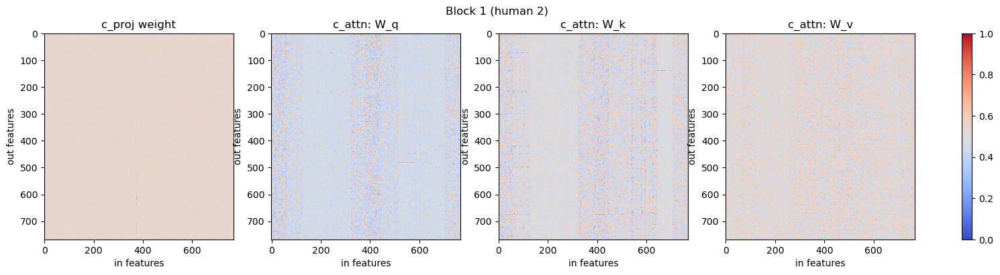

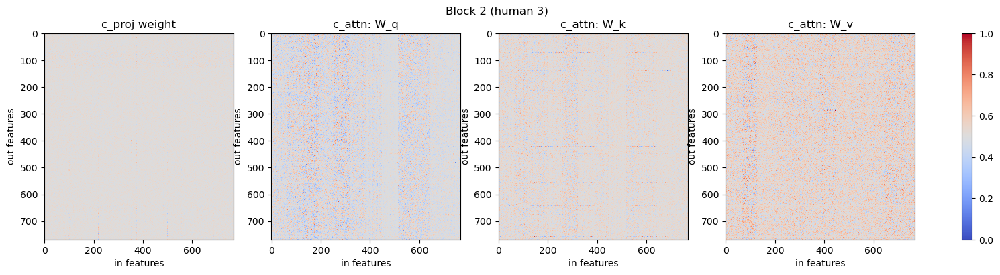

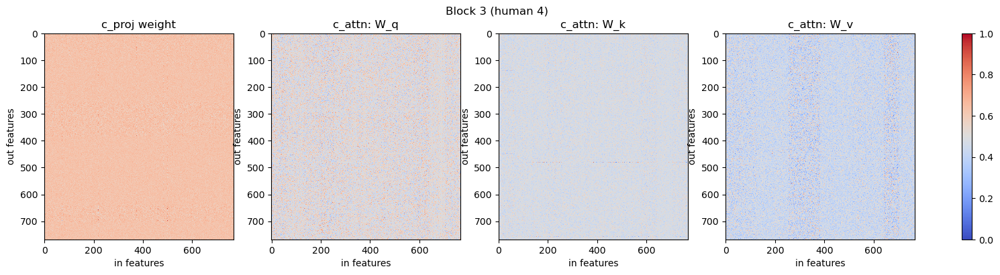

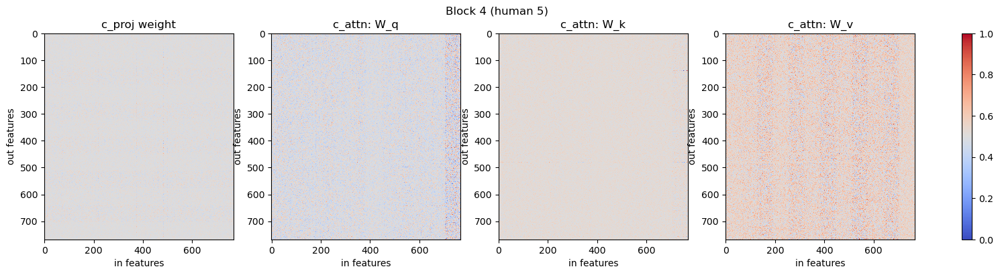

In [31]:
human_start = 2
human_end   = 5
start_idx   = human_start - 1
end_idx     = human_end - 1
n_blocks = len(model.transformer.h)
start_idx = max(0, start_idx)
end_idx   = min(n_blocks - 1, end_idx)
assert start_idx <= end_idx, "Пустой диапазон блоков"

for i in range(start_idx, end_idx + 1):
    fig, axes = show_attn_weight_matrices(model, layer_idx=i, normalize=True)
    fig.suptitle(f"Block {i} (human {i+1})")

In [32]:
import numpy as np
import matplotlib.pyplot as plt

def show_attn_matrix_fullscreen(
    model,
    layer_idx: int = 0,
    which: str = "q",            # 'q' | 'k' | 'v' | 'proj'
    normalize: bool = False,     # True -> min-max в [0,1]; False -> симметрия вокруг 0
    transpose: bool = True,      # True -> (in,out) как в «учебнике»
    cmap: str = "coolwarm",
    figsize=(22, 12),
    dpi: int = 120,
    save: str | None = None      # например: "Wq_L0.png"
):
    """
    Рисует одну из матриц внимания: Wq/Wk/Wv из c_attn или c_proj заданного слоя.
    """
    attn = model.transformer.h[layer_idx].attn
    C = attn.n_embd

    # ---- 1) Достаём нужную матрицу ----
    if which in ("q", "k", "v"):
        W_cat = attn.c_attn.weight.detach().cpu().numpy()   # (3C, C) хранение PyTorch (out, in)
        if transpose:
            # в «математический» вид (in, out) = (C, 3C) — удобно разрезать по столбцам
            W_cat = W_cat.T                                  # (C, 3C)
            sl = {"q": slice(0, C), "k": slice(C, 2*C), "v": slice(2*C, 3*C)}[which]
            W = W_cat[:, sl]                                 # (C, C)
        else:
            # режем по строкам исходной (3C, C)
            sl = {"q": slice(0, C), "k": slice(C, 2*C), "v": slice(2*C, 3*C)}[which]
            W = W_cat[sl, :]                                 # (C, C)
    elif which == "proj":
        W = attn.c_proj.weight.detach().cpu().numpy()       # (C, C) хранение (out, in)
        if transpose:
            W = W.T
    else:
        raise ValueError("which must be one of: 'q', 'k', 'v', 'proj'")

    # ---- 2) Подготовка данных к показу ----
    if normalize:
        wmin = float(W.min())
        wrng = float(W.max() - wmin)
        W_vis = (W - wmin) / wrng if wrng != 0 else np.zeros_like(W)
        vmin, vmax = 0.0, 1.0
    else:
        vmax = float(np.abs(W).max())
        vmax = vmax if vmax > 0 else 1e-8
        vmin = -vmax
        W_vis = W

    # ---- 3) Рисуем «во весь экран» (по сути — большая фигура) ----
    plt.figure(figsize=figsize, dpi=dpi)
    im = plt.imshow(W_vis, aspect='auto', interpolation='nearest',
                    cmap=cmap, vmin=vmin, vmax=vmax)
    title = f"{'W_'+which if which!='proj' else 'c_proj'}  (layer {layer_idx}) — shape {W.shape}"
    plt.title(title)
    plt.xlabel("in features")
    plt.ylabel("out features")
    plt.colorbar(im, fraction=0.02, pad=0.02)
    plt.tight_layout()

    if save:
        plt.savefig(save, dpi=300, bbox_inches="tight")
    plt.show()

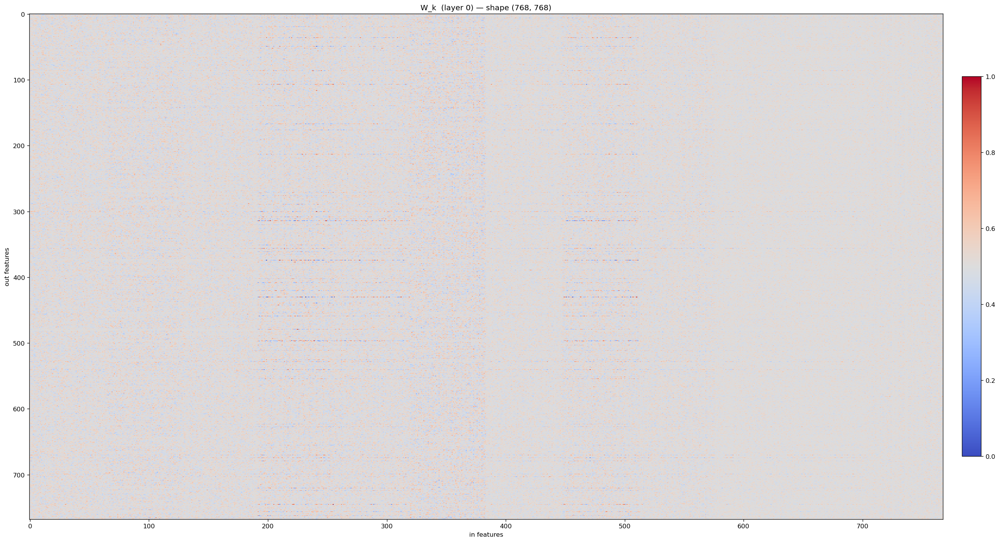

In [33]:
# печатаем одну выбранную статическую матрицу на весь экран
show_attn_matrix_fullscreen(model, layer_idx=0, which="k", normalize=True, save="Wk_L0.png")

## 2.4 Печать дельты (изменения) статических матриц 

In [34]:
def show_attn_weight_matrices_delta(
    model: GPT,
    layer_idx: int,
    transpose: bool = True,
    show_qkv: bool = True,
    cmap: str = "coolwarm",
    normalize: bool = True,
):
    """
    Показываем Δ весов внимания между блоками (layer_idx+1) и (layer_idx).
    """
    n_blocks = len(model.transformer.h)
    assert 0 <= layer_idx < n_blocks - 1, "layer_idx must be <= n_blocks-2 (нужны соседние слои)"

    attn2 = model.transformer.h[layer_idx].attn      # earlier layer (i)
    attn1 = model.transformer.h[layer_idx + 1].attn  # later   layer (i+1)

    # Compute parameter deltas (stop autograd; we’re just visualizing)
    with torch.no_grad():
        d_c_attn_w = attn1.c_attn.weight.detach() - attn2.c_attn.weight.detach()
        d_c_proj_w = attn1.c_proj.weight.detach() - attn2.c_proj.weight.detach()
        d_c_attn_b = None
        d_c_proj_b = None
        if attn1.c_attn.bias is not None:
            d_c_attn_b = attn1.c_attn.bias.detach() - attn2.c_attn.bias.detach()
        if attn1.c_proj.bias is not None:
            d_c_proj_b = attn1.c_proj.bias.detach() - attn2.c_proj.bias.detach()

    # Minimal proxy that looks like a CausalSelfAttention for plotting purposes
    class _Lin:
        def __init__(self, w, b):
            self.weight = w
            self.bias = b

    class _AttnProxy:
        def __init__(self, base_attn):
            # Copy any attributes that plot_weight_matrices uses (these are typical)
            self.n_head = getattr(base_attn, "n_head", None)
            self.n_embd = getattr(base_attn, "n_embd", None)
            self.c_attn = _Lin(d_c_attn_w, d_c_attn_b)
            self.c_proj = _Lin(d_c_proj_w, d_c_proj_b)

    proxy = _AttnProxy(attn1)

    # Reuse the original method (call it unbound, with our proxy as "self")
    return plot_weight_matrices(
        proxy, transpose=transpose, show_qkv=show_qkv, cmap=cmap, normalize=normalize
    )

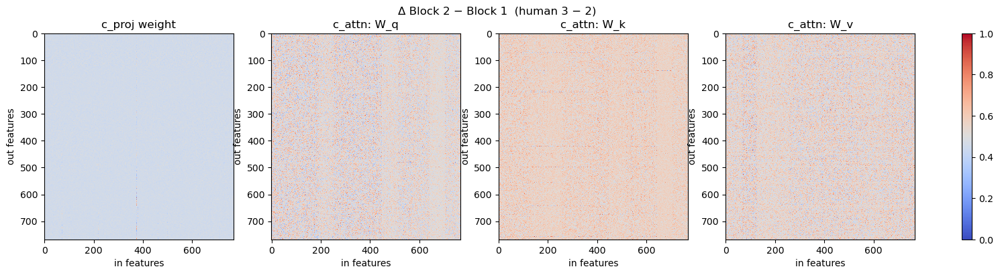

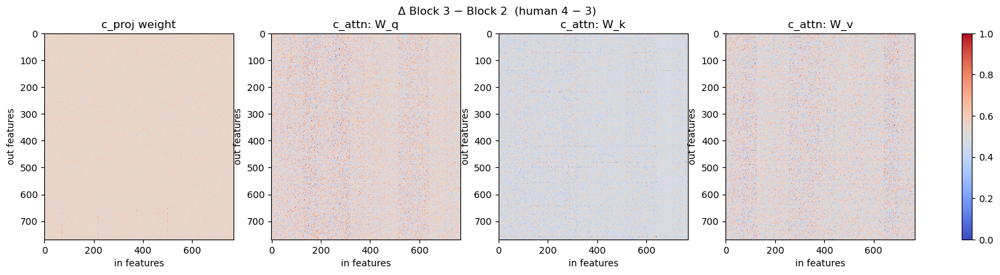

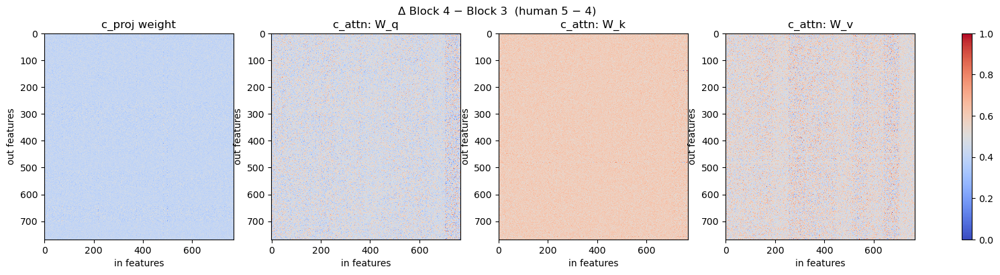

In [35]:
human_start = 2
human_end   = 4
start_idx   = human_start - 1
end_idx     = human_end - 1
n_blocks    = len(model.transformer.h)
start_idx   = max(0, start_idx)
end_idx     = min(n_blocks - 2, end_idx)  # <-- note -2 because we access i+1
assert start_idx <= end_idx, "Пустой диапазон блоков (нужно хотя бы две соседние слои)"

for i in range(start_idx, end_idx + 1):
    fig, axes = show_attn_weight_matrices_delta(model, layer_idx=i)
    fig.suptitle(f"Δ Block {i+1} − Block {i}  (human {i+2} − {i+1})")

## 2.5. Печать статических матриц по головам

In [36]:
import numpy as np
import matplotlib.pyplot as plt

def show_head_matrix_fullscreen(
    model,
    layer_idx: int = 0,
    head: int = 0,
    which: str = "q",            # 'q' | 'k' | 'v' | 'proj'
    normalize: bool = False,     # True -> min-max [0,1] (знак теряется), False -> симметрия вокруг 0
    transpose: bool = True,      # True -> (in,out) как «в учебнике»; False -> как хранит PyTorch
    cmap: str = "coolwarm",
    figsize=(22, 12),
    dpi: int = 120,
    save: str | None = None
):
    """
    Рисует МАТРИЦУ ОДНОЙ ГОЛОВЫ:
      - 'q'/'k'/'v': строки h-й головы из Wq/Wk/Wv (размер ≈ head_dim × C)
      - 'proj': столбцы h-й головы из c_proj (размер ≈ C × head_dim), т.е. вклад этой головы в выход
    """
    attn = model.transformer.h[layer_idx].attn
    C = attn.n_embd
    H = attn.n_head
    hd = C // H
    if not (0 <= head < H):
        raise ValueError(f"head must be in [0,{H-1}]")

    # ---- 1) Достаём Wq/Wk/Wv или c_proj ----
    if which in ("q", "k", "v"):
        W_cat = attn.c_attn.weight.detach().cpu().numpy()     # (3C, C) = (out, in)
        if transpose:
            W_cat = W_cat.T                                   # (C, 3C) = (in, out)
            W_q = W_cat[:, :C]        # (C,C)
            W_k = W_cat[:, C:2*C]     # (C,C)
            W_v = W_cat[:, 2*C:]      # (C,C)
        else:
            W_q = W_cat[:C, :]        # (C,C)
            W_k = W_cat[C:2*C, :]     # (C,C)
            W_v = W_cat[2*C:, :]      # (C,C)

        base = {"q": W_q, "k": W_k, "v": W_v}[which]

        # Для одной головы берём БЛОК СТРОК, соответствующий head
        W = base[head*hd:(head+1)*hd, :]                       # (head_dim, C)

    elif which == "proj":
        # c_proj: (C, C) = (out, in). Берём вклад входа от этой головы => БЛОК СТОЛБЦОВ
        Wp = attn.c_proj.weight.detach().cpu().numpy()         # (C, C)
        if transpose:
            Wp = Wp.T                                          # (C, C) -> «in,out»-вид
        W = Wp[:, head*hd:(head+1)*hd]                         # (C, head_dim)
    else:
        raise ValueError("which must be one of: 'q', 'k', 'v', 'proj'")

    # ---- 2) Подготовка визуализации ----
    if normalize:
        wmin = float(W.min())
        wrng = float(W.max() - wmin)
        W_vis = (W - wmin) / wrng if wrng != 0 else np.zeros_like(W)
        vmin, vmax = 0.0, 1.0
    else:
        vmax = float(np.abs(W).max()) or 1e-8
        vmin = -vmax
        W_vis = W

    # ---- 3) Большая фигура «на весь экран» ----
    plt.figure(figsize=figsize, dpi=dpi)
    im = plt.imshow(W_vis, aspect='auto', interpolation='nearest',
                    cmap=cmap, vmin=vmin, vmax=vmax)

    # Подписи осей: у 'q/k/v' по Y — выходы этой головы (head_dim), по X — входные признаки (C)
    # у 'proj' по Y — выходные признаки (C), по X — вход от этой головы (head_dim)
    title = (f"W_{which.upper()} head={head} (layer {layer_idx}) — shape {W.shape}"
             if which != "proj" else
             f"c_proj[:, head {head}] (layer {layer_idx}) — shape {W.shape}")
    plt.title(title)
    plt.xlabel("in features" if which != "proj" else "from head features")
    plt.ylabel("out features" if which != "proj" else "to output features")
    plt.colorbar(im, fraction=0.02, pad=0.02)
    plt.tight_layout()
    if save:
        plt.savefig(save, dpi=300, bbox_inches="tight")
    plt.show()


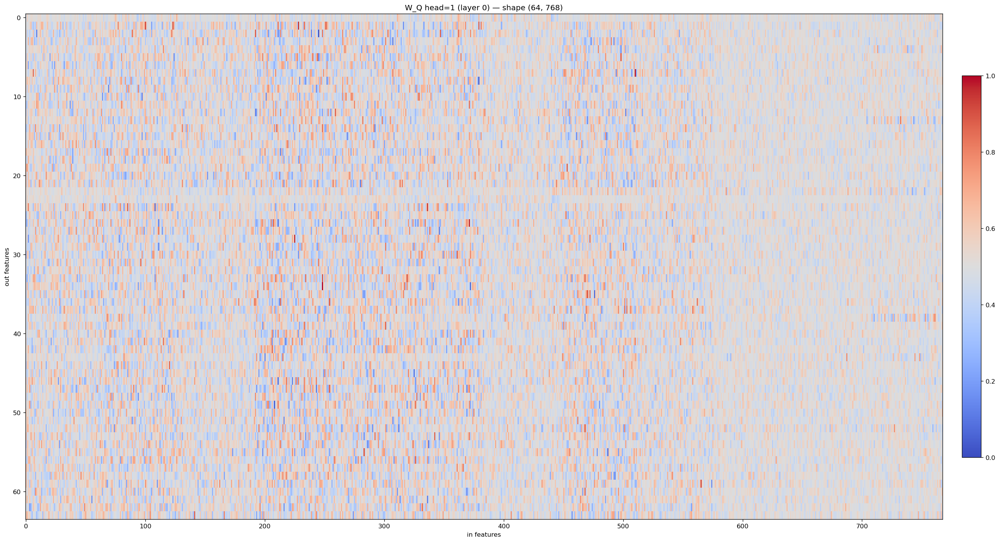

In [37]:
# печатаем одну выбранную голову одной выбранной статической матрицы на весь экран
show_head_matrix_fullscreen(model, layer_idx=0, head=1, which="q", normalize=True)

In [38]:
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

def _extract_Wqkv(attn, transpose=True):
    C = attn.n_embd
    W_cat = attn.c_attn.weight.detach().cpu().numpy()  # (3C, C) хранение (out,in)
    if transpose:
        W_cat = W_cat.T                                 # (C, 3C) «учебный» вид
        W_q = W_cat[:, :C]
        W_k = W_cat[:, C:2*C]
        W_v = W_cat[:, 2*C:]
    else:
        W_q = W_cat[:C, :]
        W_k = W_cat[C:2*C, :]
        W_v = W_cat[2*C:, :]
    return W_q, W_k, W_v

In [39]:

def _extract_proj(attn, transpose=True):
    Wp = attn.c_proj.weight.detach().cpu().numpy()      # (C, C) хранение (out,in)
    return Wp.T if transpose else Wp

def _get_head_block(W, head, head_dim, which):
    # q/k/v: берем БЛОК СТРОК head*hd:(head+1)*hd
    # proj:  берем БЛОК СТОЛБЦОВ для входа от этой головы
    if which in ("q","k","v"):
        return W[head*head_dim:(head+1)*head_dim, :]              # (hd, C)
    else:  # 'proj'
        return W[:, head*head_dim:(head+1)*head_dim]              # (C, hd)

In [40]:
def _normalize(M, mode="none", pct=1.0):
    """
    mode:
      - 'none'        : симметрия вокруг 0 глобально
      - 'percentile'  : обрезка по перцентилям ±pct (пример: 1.0 -> [1-й, 99-й])
      - 'two_slope'   : TwoSlopeNorm(center=0) с перцентильным клиппингом
      - 'zscore'      : (M - mean) / std (если std>0), затем клип ±N*std через pct
    """
    m = M.copy()
    if mode == "none":
        vmax = float(np.abs(m).max()) or 1e-8
        return m, (-vmax, vmax)

    elif mode == "percentile":
        lo = np.percentile(m, pct)
        hi = np.percentile(m, 100-pct)
        if lo == hi:  # на случай константы
            return np.zeros_like(m), (0.0, 1.0)
        m = np.clip(m, lo, hi)
        return m, (lo, hi)

    elif mode == "two_slope":
        lo = np.percentile(m, pct)
        hi = np.percentile(m, 100-pct)
        # вернем значения и диапазон; сам TwoSlopeNorm применим в imshow
        return np.clip(m, lo, hi), ("two_slope", lo, hi)
    elif mode == "zscore":
        mu = float(m.mean())
        sd = float(m.std())
        if sd == 0:
            return np.zeros_like(m), (-1.0, 1.0)
        z = (m - mu) / sd
        # pct трактуем как «сколько std отрезать»: 1.0 -> клип ±3σ, 0.5 -> ±2σ и т.п.
        nstd = 3.0 if pct is None else max(0.5, 0.5 + 2.5*(pct/100))  # мягкая шкала
        z = np.clip(z, -nstd, nstd)
        return z, (-nstd, nstd)

    else:
        raise ValueError("mode must be one of: none, percentile, two_slope, zscore")

In [41]:
def plot_all_heads_matrix(
    model,
    layer_idx: int = 0,
    which: str = "q",           # 'q' | 'k' | 'v' | 'proj'
    transpose: bool = True,
    norm_mode: str = "percentile",  # 'none'|'percentile'|'two_slope'|'zscore'
    pct: float = 1.0,           # для 'percentile' = обрезка [pct, 100-pct]
    per_head: bool = True,      # нормировать КАЖДУЮ голову отдельно (рекомендуется)
    figsize=(20, 14),
    dpi: int = 120,
    cmap: str = "coolwarm"
):
    """
    Рисует сетку из всех голов выбранной матрицы:
      - 'q','k','v': каждый сабплот показывает строки (hd, C) для головы
      - 'proj'     : каждый сабплот показывает столбцы (C, hd), вклад головы в выход
    """
    attn = model.transformer.h[layer_idx].attn
    C, H = attn.n_embd, attn.n_head
    hd = C // H

    if which in ("q","k","v"):
        W_q, W_k, W_v = _extract_Wqkv(attn, transpose=transpose)
        base = {"q": W_q, "k": W_k, "v": W_v}[which]
        blocks = [ _get_head_block(base, h, hd, which) for h in range(H) ]   # (hd, C)
    elif which == "proj":
        Wp = _extract_proj(attn, transpose=transpose)
        blocks = [ _get_head_block(Wp,  h, hd, which) for h in range(H) ]    # (C, hd)
    else:
        raise ValueError("which must be 'q','k','v','proj'")

    # Глобальные min/max для режимов без per_head
    if not per_head and norm_mode in ("none","percentile"):
        big = np.concatenate([b.flatten() for b in blocks])
        if norm_mode == "none":
            vmax = float(np.abs(big).max()) or 1e-8
            global_range = (-vmax, vmax)
        else:
            lo = np.percentile(big, pct)
            hi = np.percentile(big, 100-pct)
            if lo == hi:
                global_range = (0.0, 1.0)
            else:
                global_range = (lo, hi)
    else:
        global_range = None

    cols = min(8, H)
    rows = math.ceil(H / cols)
    fig, axes = plt.subplots(rows, cols, figsize=figsize, dpi=dpi)
    axes = np.atleast_2d(axes).reshape(rows, cols)

    for h in range(H):
        r, c = divmod(h, cols)
        ax = axes[r, c]
        M = blocks[h]

        if per_head:
            Mv, rng = _normalize(M, norm_mode, pct)
            if norm_mode == "two_slope" and isinstance(rng, tuple) and rng[0] == "two_slope":
                _, lo, hi = rng
                norm = TwoSlopeNorm(vmin=lo, vcenter=0.0, vmax=hi)
                im = ax.imshow(np.clip(Mv, lo, hi), aspect='auto', cmap=cmap, norm=norm)
            else:
                vmin, vmax = rng
                im = ax.imshow(Mv, aspect='auto', cmap=cmap, vmin=vmin, vmax=vmax)
        else:
            if norm_mode == "two_slope":
                lo, hi = global_range
                norm = TwoSlopeNorm(vmin=lo, vcenter=0.0, vmax=hi)
                im = ax.imshow(np.clip(M, lo, hi), aspect='auto', cmap=cmap, norm=norm)
            else:
                vmin, vmax = global_range if global_range else (-1, 1)
                im = ax.imshow(np.clip(M, vmin, vmax), aspect='auto', cmap=cmap, vmin=vmin, vmax=vmax)

        ax.set_title(f"h {h}")
        ax.set_xticks([]); ax.set_yticks([])

    # Удалим пустые оси (если H не кратно cols)
    for k in range(H, rows*cols):
        r, c = divmod(k, cols)
        fig.delaxes(axes[r, c])

    fig.suptitle(f"{'W_'+which if which!='proj' else 'c_proj'}  — layer {layer_idx}", y=0.995)
    plt.tight_layout()
    plt.show()


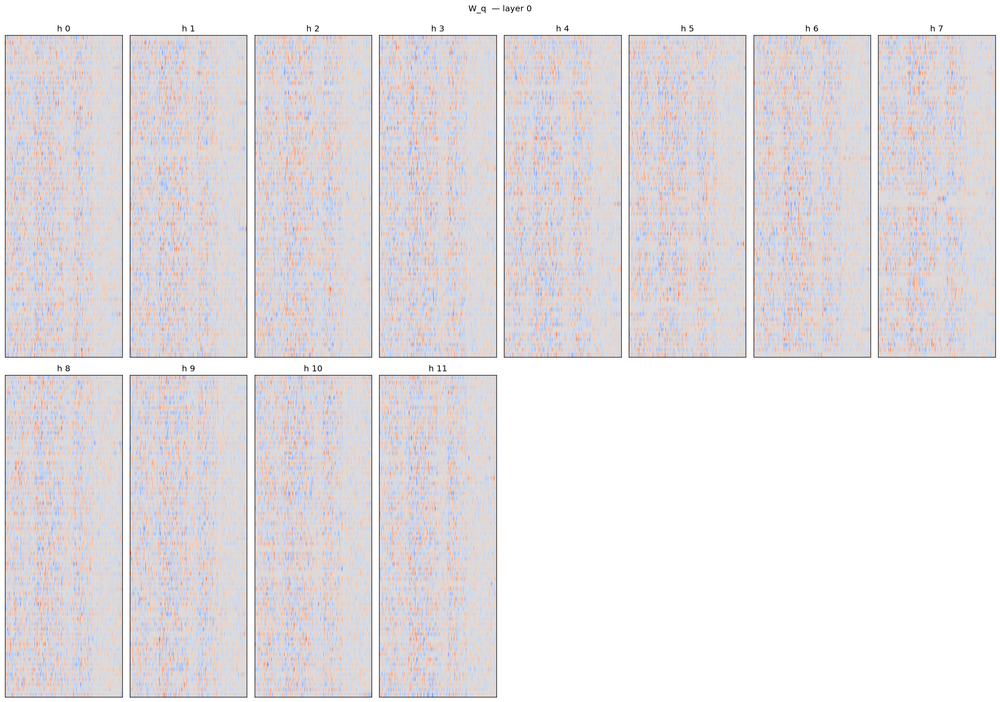

In [42]:
plot_all_heads_matrix(model, layer_idx=0, which="q",
                      norm_mode="two_slope", pct=1.0, per_head=True)


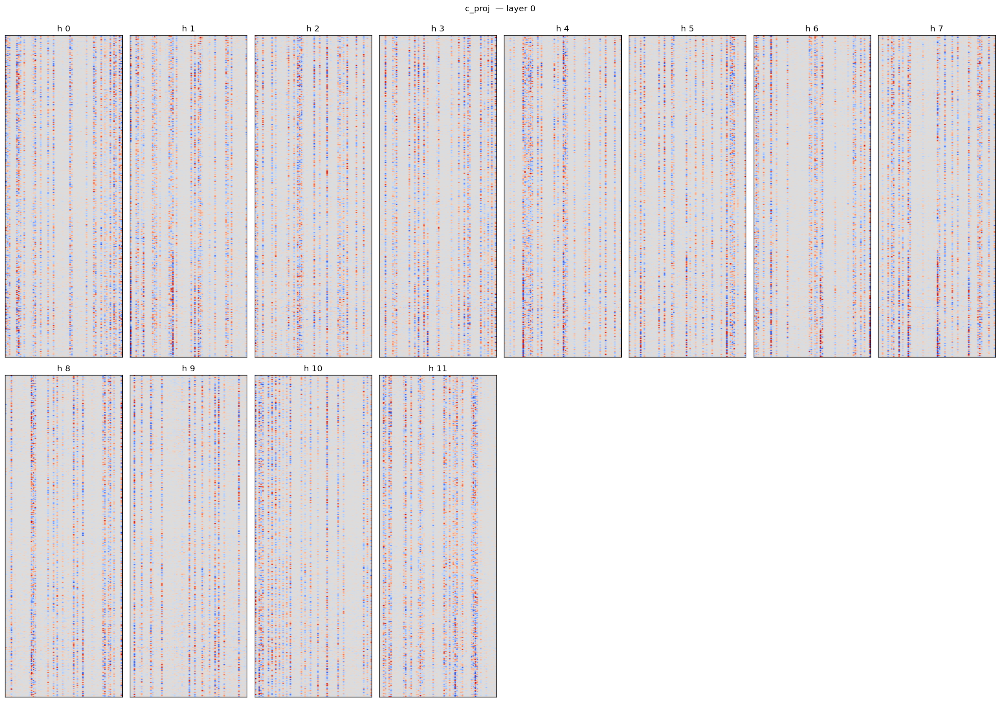

In [43]:
plot_all_heads_matrix(model, layer_idx=0, which="proj",
                      norm_mode="two_slope", pct=1.0, per_head=True)

## 2.6. Печать промпта и токенов

In [44]:
# run generation

ENABLE_Q_EVOLUTION = True   # или False, чтобы отключить
Q_LAYER_TO_PLOT   = 0       # какой слой смотреть
Q_HEAD_TO_PLOT    = 1       # какую голову в этом слое

print("печать промпта")
#print(start_prompt)
print(decode(x[0].tolist()))

print ("печать токенов")
with torch.no_grad():
    with ctx:
        for k in range(num_samples):
            if ENABLE_Q_EVOLUTION:
                # Генерация с сохранением истории Q
                y, q_history = generate_with_q_history(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (с эволюцией Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')

                

            else:
                # Обычная генерация без логирования Q
                y = generate(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                # print(f"=== sample {k+1} (без эволюции Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')


печать промпта
quick_sort in Python is 
печать токенов
=== sample 1 (с эволюцией Q) ===
quick_sort in Python is  to sort by the number of rows in a
---------------


In [45]:
torch.manual_seed(seed)
if device_type == "cuda":
    torch.cuda.manual_seed(seed)

print("печать промпта")
print(start_prompt)

print("печать токенов")
with torch.no_grad():
    with ctx:
        # допустим, смотрим только один пример
        y, q_history = generate_with_q_history(
            model,
            idx=x,
            max_new_tokens=max_new_tokens,
            temperature=temperature,
            top_k=top_k,
        )
        print(decode(y[0].tolist()))
        print('---------------')

        # А теперь — эволюция Q для, скажем, слоя 0, головы 0
        # plot_q_evolution(q_history, layer_idx=0, head_idx=0)


печать промпта
quick_sort in Python is 
печать токенов
quick_sort in Python is  to sort the data by a given number.
---------------


## 2.7 Печать динамических матриц

In [46]:
ENABLE_Q_EVOLUTION = True   # или False, чтобы отключить
Q_LAYER_TO_PLOT   = 0       # какой слой смотреть
Q_HEAD_TO_PLOT    = 1       # какую голову в этом слое

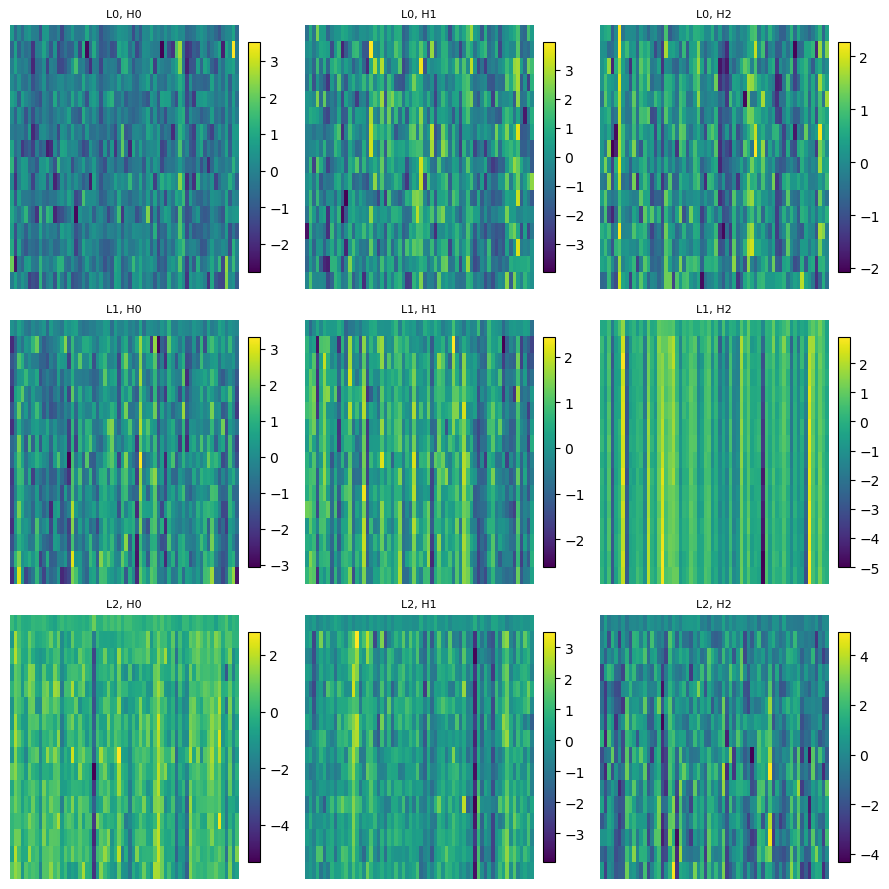

In [47]:
# а это уже печать динамических матриц
range_layer_idx = 3  # слой
num_head_idx = 3   # диапазон голов

fig, axes = plt.subplots(
    nrows=range_layer_idx,
    ncols=num_head_idx,
    figsize=(3 * num_head_idx, 3 * range_layer_idx)  # масштабируем по числу картинок
)

# если 1 строка или 1 столбец — привести axes к 2D
if range_layer_idx == 1:
    axes = np.expand_dims(axes, axis=0)
if num_head_idx == 1:
    axes = np.expand_dims(axes, axis=1)

for layer_idx in range(range_layer_idx):
    attn = model.transformer.h[layer_idx].attn
    for head_idx in range(num_head_idx):
        q = attn.last_q[0, head_idx]

        ax = axes[layer_idx, head_idx]
        im = ax.imshow(q, aspect='auto', interpolation='nearest')
        ax.set_title(f"L{layer_idx}, H{head_idx}", fontsize=8)
        ax.axis('off')  # убираем оси для компактности
        fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.tight_layout()   
plt.show()    


### 2.7.1. Динамические матрицы: новые строчки с подписями строк 

quick_sort in Python is  to sort by the number of rows in a
---------------


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\4240107945.py:142: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


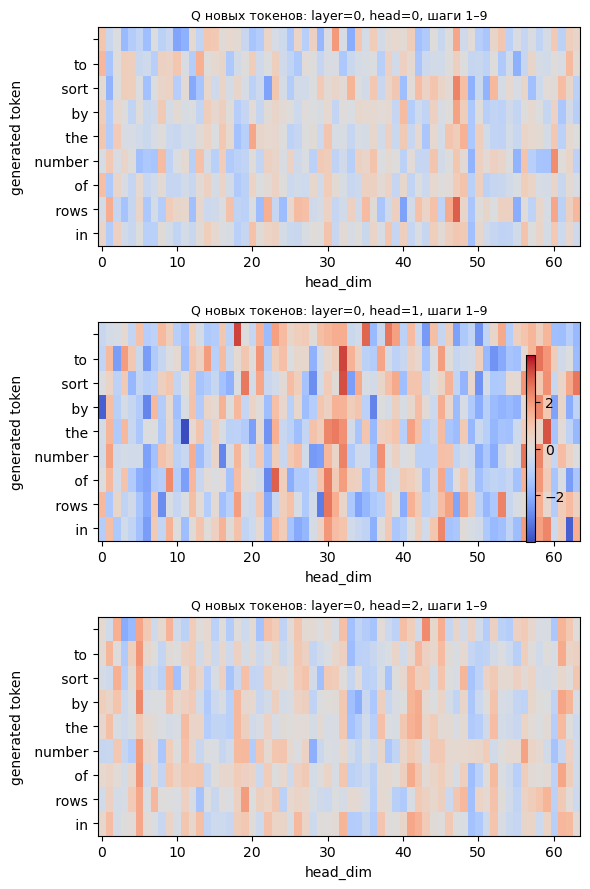

In [48]:
with torch.no_grad():
    with ctx:
        y, q_history = generate_with_q_history(
            model,
            idx=x,
            max_new_tokens=max_new_tokens,
            temperature=temperature,
            top_k=top_k,
        )

        print(decode(y[0].tolist()))
        print("---------------")

        # 1) отделяем сгенерированные токены (хвост после промпта)
        prompt_len = x.size(1)              # длина промпта L0
        full_ids   = y[0].tolist()          # все токены: промпт + сгенерированные
        gen_ids    = full_ids[prompt_len:]  # только сгенерированные токены

        # 2) делаем подписи для каждой строки:
        #    decode по одному токену, чтобы увидеть именно "кусочек" (BPE-токен)
        token_labels = [decode([tid]) for tid in gen_ids]

        # 3) рисуем Q для новых токенов с подписями
        plot_q_new_token_rows(
            q_history,
            layer_idx=0,
            head_idx=0,
            heads=[0, 1, 2],       # несколько голов
            skip_prompt=True,       # step=1 -> первый сгенерированный токен
            token_labels=token_labels,
        )


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\817722402.py:161: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


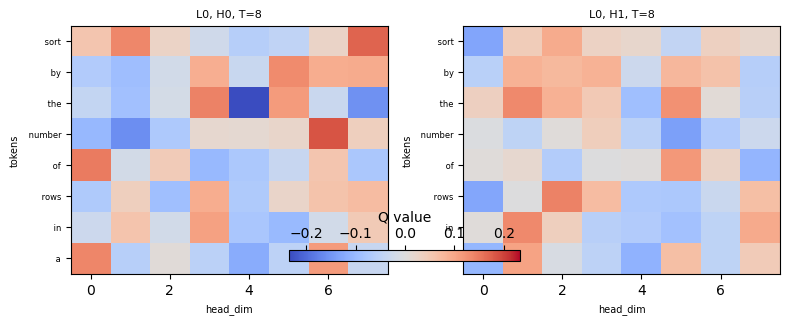

In [49]:
token_ids = full_ids  # весь контекст, промпт + сгенерированные

plot_q_final_with_token_labels(
    model=m,
    token_ids=token_ids,
    layer_idx=0,          # интересующий слой
    heads=[0, 1, 2, 3],   # какие головы показать в этом слое
    decode_fn=decode,
)


### 2.7.2 Динамические матрицы: все матрицы с подписями строк

In [50]:
print("TEXT:", decode(y[0].tolist()))
print("LAST 30 ids:", y[0].tolist()[-30:])
print("prompt_len:", x.size(1))
prompt_ids = x[0].tolist()
full_ids   = y[0].tolist()
gen_ids    = full_ids[len(prompt_ids):]

TEXT: quick_sort in Python is  to sort by the number of rows in a
LAST 30 ids: [24209, 62, 30619, 287, 11361, 318, 220, 1849, 1462, 3297, 416, 262, 1271, 286, 15274, 287, 257]
prompt_len: 7


In [51]:
print("FULL:", decode(full_ids))
print("GEN :", decode(gen_ids))
print("gen_ids[:15] tokens:", [decode([t]) for t in gen_ids[:15]])

FULL: quick_sort in Python is  to sort by the number of rows in a
GEN :  to sort by the number of rows in a
gen_ids[:15] tokens: ['\xa0', 'to', ' sort', ' by', ' the', ' number', ' of', ' rows', ' in', ' a']


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\2804391670.py:126: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


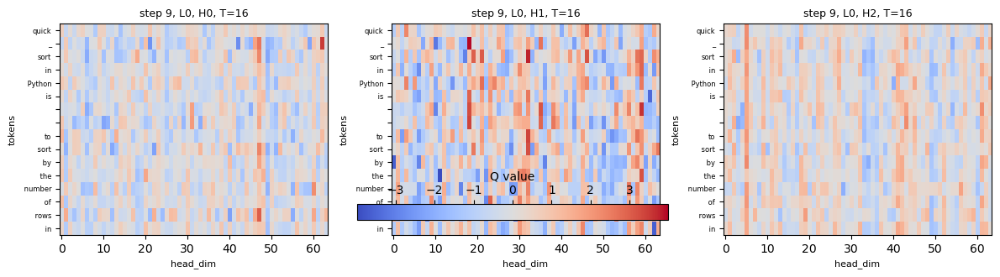

Важно: q_history[-1] у вас соответствует контексту ДО генерации последнего токена. Если нужно включить и самый последний сгенерированный токен в строки, нужен дополнительный forward на полной последовательности (см. ниже).


In [52]:
plot_q_last_step_multiheads(
    q_history,
    layer_idx=0,
    heads=[0, 1, 2],
    step=None,                 # последний сохранённый step
    token_ids_prompt=prompt_ids,
    token_ids_generated=gen_ids,
    decode_fn=decode,
)


In [53]:
t2_itogo = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'весь необходимый код код занял', round(t2_itogo - t1_itogo)//60,'минут', 
      round(t2_itogo - t1_itogo)%60,'секунд')

при количестве создаваемых токенов  10 и прогонов  1 весь необходимый код код занял 0 минут 59 секунд


# 3. Дальше весь код, который пока не важен и/или непонятен 

## 3.1. Сходство весов пока не очень понятно. 
Пусть печатается, но внизу, чтобы не мешать восприятию печати матриц 

In [54]:
def _cosine_sim(a: torch.Tensor, b: torch.Tensor, eps: float = 1e-9) -> float:
    a = a.flatten()
    b = b.flatten()
    return (a @ b).item() / ((a.norm() + eps) * (b.norm() + eps))


In [55]:

def _slice_head(W, h, head_dim, split_axis: str):
    """
    Возвращает срез матрицы W для головы h.
    - Если split_axis == 'row'  → берём строки [h*head_dim : (h+1)*head_dim, :]
    - Если split_axis == 'col'  → берём столбцы [:, h*head_dim : (h+1)*head_dim]
    """
    if split_axis == "row":
        return W[h*head_dim:(h+1)*head_dim, :]
    elif split_axis == "col":
        return W[:, h*head_dim:(h+1)*head_dim]
    else:
        raise ValueError("split_axis must be 'row' or 'col'")

In [56]:
def _procrustes_error(A: torch.Tensor, B: torch.Tensor, eps: float = 1e-9) -> float:
    """
    Procrustes: ищем ортогональный R, минимизирующий ||A - B R||_F / ||A||_F.
    Важно: форма A и B должна позволять умножение B @ R.
    Для устойчивости ожидаем, что W головы идёт как (head_dim, C) либо (C, head_dim).
    Если ты работаешь в режиме split_axis='col' (головы по столбцам), то W_slice имеет форму (C, head_dim).
    Тогда подгоняем к виду (head_dim, C), чтобы B.T @ A имел форму (head_dim, head_dim).
    """
    # Приведём к виду (head_dim, C)
    if A.shape[0] < A.shape[1]:   # (head_dim, C)
        A_use = A
    else:                         # (C, head_dim) → транспонируем
        A_use = A.t()
    if B.shape[0] < B.shape[1]:
        B_use = B
    else:
        B_use = B.t()

    # Теперь A_use,B_use: (head_dim, C)
    M = B_use.T @ A_use           # (C, C) → SVD
    U, _, Vt = torch.linalg.svd(M, full_matrices=False)
    R = U @ Vt
    num = (A_use - B_use @ R).norm()
    den = A_use.norm() + eps
    return (num / den).item()



In [57]:
def _greedy_match_heads(W_l, W_lp1, head_dim, split_axis: str):
    """
    Жадное сопоставление голов между соседними слоями по косинусной похожести.
    Возвращает список пар (h_in_l, matched_h_in_lp1)
    и матрицу похожестей (n_head x n_head).
    """
    if split_axis == "row":
        n_head = W_l.shape[0] // head_dim
    else:
        n_head = W_l.shape[1] // head_dim

    # считаем матрицу косинусов между всеми головами
    sims = torch.empty(n_head, n_head)
    for h0 in range(n_head):
        a = _slice_head(W_l,   h0, head_dim, split_axis)
        for h1 in range(n_head):
            b = _slice_head(W_lp1, h1, head_dim, split_axis)
            sims[h0, h1] = _cosine_sim(a, b)

    # жадное сопоставление: для каждой головы в l берём наилучшую в l+1,
    # не позволяя двум разным головам взять одну и ту же пару
    matched = [-1] * n_head
    taken = set()
    for h0 in range(n_head):
        # выбираем h1 с максимальным косинусом, который ещё не взят
        best_h1 = None
        best_val = -1e9
        for h1 in range(n_head):
            if h1 in taken:
                continue
            val = sims[h0, h1].item()
            if val > best_val:
                best_val, best_h1 = val, h1
        matched[h0] = best_h1
        taken.add(best_h1)

    pairs = [(h0, matched[h0]) for h0 in range(n_head)]
    return pairs, sims


def compare_blocks_range(
    model,
    start_idx: int,
    end_idx: int,
    *,
    which: str = "q",                 # 'q' | 'k' | 'v'
    transpose_for_math: bool = True,  # как вырезаем головы (см. extract)
    plot: bool = True,
    title: str | None = None,
):
    """
    Сравнивает выбранный тип весов (q/k/v) между соседними блоками на диапазоне [start_idx, end_idx].
    Для каждой пары слоёв l -> l+1:
      1) жадно сопоставляет головы по косинусу;
      2) считает косинус и Procrustes-ошибку по каждой сопоставленной голове;
      3) усредняет метрики по головам.
    Возвращает словарь с метриками и (опц.) рисует графики средних метрик по слоям.
    """
    assert 0 <= start_idx < end_idx < len(model.transformer.h), "Проверь границы диапазона"
    assert which in {"q", "k", "v"}

    avg_cosines = []      # средний косинус по головам для каждой пары слоёв
    avg_procr = []        # средняя Procrustes-ошибка по головам
    layer_pairs = []      # список пар (l, l+1), чтобы подписывать ось X

    for l in range(start_idx, end_idx):
        attn_l   = model.transformer.h[l].attn
        attn_lp1 = model.transformer.h[l+1].attn

        Wq_l, Wk_l, Wv_l, C, n_head, head_dim, split_axis = _extract_WqWkWv_from_attn(
            attn_l, transpose_for_math=transpose_for_math
        )
        Wq_p, Wk_p, Wv_p, *_ = _extract_WqWkWv_from_attn(
            attn_lp1, transpose_for_math=transpose_for_math
        )

        W_l  = {"q": Wq_l, "k": Wk_l, "v": Wv_l}[which]
        W_p1 = {"q": Wq_p, "k": Wk_p, "v": Wv_p}[which]

        # сопоставляем головы
        pairs, sims_mat = _greedy_match_heads(W_l, W_p1, head_dim, split_axis)

        cos_vals = []
        pro_vals = []
        for h0, h1 in pairs:
            A = _slice_head(W_l,  h0, head_dim, split_axis)
            B = _slice_head(W_p1, h1, head_dim, split_axis)
            cos_vals.append(_cosine_sim(A, B))
            pro_vals.append(_procrustes_error(A, B))

        avg_cosines.append(float(torch.tensor(cos_vals).mean()))
        avg_procr.append(float(torch.tensor(pro_vals).mean()))
        layer_pairs.append((l, l+1))

    metrics = {
        "layer_pairs": layer_pairs,
        "avg_cosine":  avg_cosines,
        "avg_procrustes": avg_procr,
        "which": which,
        "transpose_for_math": transpose_for_math,
    }

    if plot:
        xs = list(range(len(layer_pairs)))
        fig, axes = plt.subplots(1, 2, figsize=(10, 4))
        axes[0].plot(xs, avg_cosines, marker="o")
        axes[0].set_title(f"Средний косинус по головам ({which})")
        axes[0].set_xlabel("пара слоёв l→l+1")
        axes[0].set_ylabel("cosine")
        axes[0].set_xticks(xs, [f"{l}→{lp1}" for (l, lp1) in layer_pairs], rotation=0)

        axes[1].plot(xs, avg_procr, marker="o")
        axes[1].set_title(f"Средняя Procrustes-ошибка по головам ({which})")
        axes[1].set_xlabel("пара слоёв l→l+1")
        axes[1].set_ylabel("error (↓ лучше)")
        axes[1].set_xticks(xs, [f"{l}→{lp1}" for (l, lp1) in layer_pairs], rotation=0)

        if title:
            fig.suptitle(title, y=1.03)
        fig.tight_layout()
        metrics["figure"] = fig
        metrics["axes"] = axes

    return metrics

In [58]:
# ======== utils: извлечение и сравнение Wq/Wk/Wv по диапазону блоков ========
def _extract_WqWkWv_from_attn(attn, *, transpose_for_math: bool = True):
    """
    Возвращает (Wq, Wk, Wv, C, n_head, head_dim) для данного attn-модуля.
    - Если transpose_for_math=True → Wcat в виде (in=C, out=3C), режем по столбцам.
    - Иначе оставляем pytorch-вид (out=3C, in=C), режем по строкам.
    """
    Wcat = attn.c_attn.weight.detach().cpu()  # (3C, C) в PT-представлении (out, in)
    C = attn.n_embd
    n_head = attn.n_head
    head_dim = C // n_head

    if transpose_for_math:
        Wcat = Wcat.t()                       # (C, 3C): (in, out)
        Wq = Wcat[:, 0*C:1*C]                 # (C, C)
        Wk = Wcat[:, 1*C:2*C]                 # (C, C)
        Wv = Wcat[:, 2*C:3*C]                 # (C, C)
        split_axis = "col"                    # головы → по столбцам
    else:
        Wq = Wcat[0*C:1*C, :]                 # (C, C)
        Wk = Wcat[1*C:2*C, :]                 # (C, C)
        Wv = Wcat[2*C:3*C, :]                 # (C, C)
        split_axis = "row"                    # головы → по строкам

    return Wq, Wk, Wv, C, n_head, head_dim, split_axis

In [59]:

def compare_blocks_range_all_three(
    model,
    start_idx: int,
    end_idx: int,
    *,
    transpose_for_math: bool = True,
    plot: bool = True,
    suptitle: str | None = None,
):
    """
    Удобная «панель»: запускает сравнение для q, k, v и рисует 2x3 графика:
      (cos_q, cos_k, cos_v) и (proc_q, proc_k, proc_v).
    Возвращает словарь с тремя наборами метрик.
    """
    res_q = compare_blocks_range(
        model, start_idx, end_idx, which="q",
        transpose_for_math=transpose_for_math, plot=False
    )
    res_k = compare_blocks_range(
        model, start_idx, end_idx, which="k",
        transpose_for_math=transpose_for_math, plot=False
    )
    res_v = compare_blocks_range(
        model, start_idx, end_idx, which="v",
        transpose_for_math=transpose_for_math, plot=False
    )

    if plot:
        xs = list(range(len(res_q["layer_pairs"])))
        fig, axes = plt.subplots(2, 3, figsize=(14, 6))
        # cosines
        axes[0,0].plot(xs, res_q["avg_cosine"], marker="o"); axes[0,0].set_title("cos(q)")
        axes[0,1].plot(xs, res_k["avg_cosine"], marker="o"); axes[0,1].set_title("cos(k)")
        axes[0,2].plot(xs, res_v["avg_cosine"], marker="o"); axes[0,2].set_title("cos(v)")
        # procrustes
        axes[1,0].plot(xs, res_q["avg_procrustes"], marker="o"); axes[1,0].set_title("proc(q) ↓")
        axes[1,1].plot(xs, res_k["avg_procrustes"], marker="o"); axes[1,1].set_title("proc(k) ↓")
        axes[1,2].plot(xs, res_v["avg_procrustes"], marker="o"); axes[1,2].set_title("proc(v) ↓")

        for ax in axes.flatten():
            ax.set_xlabel("пара слоёв l→l+1")
            ax.set_xticks(xs, [f"{l}→{lp1}" for (l, lp1) in res_q["layer_pairs"]], rotation=0)

        if suptitle:
            fig.suptitle(suptitle, y=1.03)
        fig.tight_layout()

        return {"q": res_q, "k": res_k, "v": res_v, "figure": fig, "axes": axes}
    else:
        return {"q": res_q, "k": res_k, "v": res_v}
# ======== end utils ========



C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\817722402.py:161: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


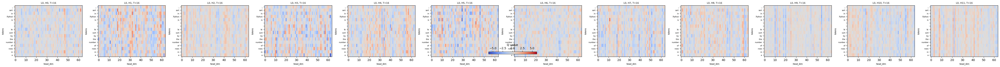

In [60]:
full_ids = y[0].tolist()
plot_q_final_with_token_labels(
    model,
    token_ids=full_ids,
    layer_idx=0,
    head_idx=0,
    decode_fn=lambda ids: decode(ids),
)


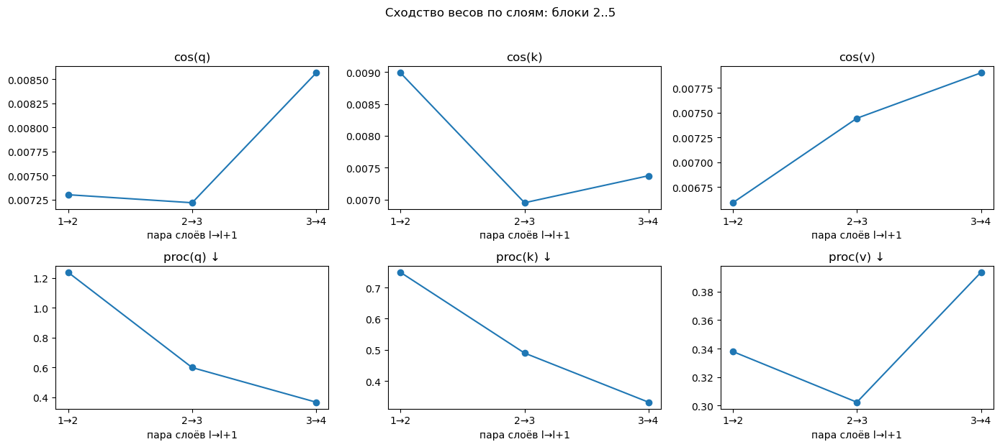

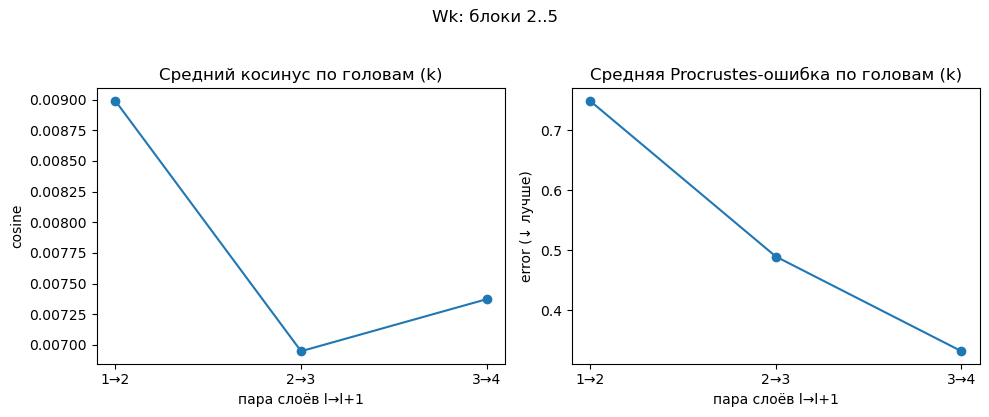

In [61]:
#cходставо весов тоже пока не очень понятно. Пусть печатается, но внизу, чтобы не мешать восприятию печати матриц
# человеческие номера 2..5 → python-индексы 1..4
human_start, human_end = 2, 5
start_idx = human_start - 1
end_idx   = human_end   - 1

# 1) панель для q/k/v сразу
_ = compare_blocks_range_all_three(
    model, start_idx, end_idx,
    transpose_for_math=True,   # как ты обычно смотришь матрицы
    plot=True,
    suptitle=f"Сходство весов по слоям: блоки {human_start}..{human_end}"
)

# 2) только, скажем, Wk — для детального анализа
_ = compare_blocks_range(
    model, start_idx, end_idx,
    which="k",
    transpose_for_math=True,
    plot=True,
    title=f"Wk: блоки {human_start}..{human_end}"
)

## 3.2. Разное закомменченное рисование, потому что оно пока не выглядит познавательным и не дает выложить в GitHub ##

### 3.2.1. Тут функции для печати с сортировкой по головам, не выглядит особо вдохновляюще

In [62]:
# со всякой хитрой сортировкой по головам, не выглядит особо вдохновляюще
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# ---------- Вспомогательные извлекатели ----------
def _extract_Wqkv(attn, transpose=True):
    C = attn.n_embd
    W_cat = attn.c_attn.weight.detach().cpu().numpy()  # (3C, C) хранение (out,in)
    if transpose:
        W_cat = W_cat.T                                 # (C, 3C) «учебный» вид (in,out)
        W_q = W_cat[:, :C]
        W_k = W_cat[:, C:2*C]
        W_v = W_cat[:, 2*C:]
    else:
        W_q = W_cat[:C, :]
        W_k = W_cat[C:2*C, :]
        W_v = W_cat[2*C:, :]
    return W_q, W_k, W_v

def _extract_proj(attn, transpose=True):
    Wp = attn.c_proj.weight.detach().cpu().numpy()      # (C, C) хранение (out,in)
    return Wp.T if transpose else Wp

def _get_head_block(W, head, head_dim, which):
    # Для q/k/v: строки соответствующей головы; для proj: столбцы этой головы
    if which in ("q","k","v"):
        return W[head*head_dim:(head+1)*head_dim, :]    # (hd, C)
    else:  # 'proj'
        return W[:, head*head_dim:(head+1)*head_dim]    # (C, hd)

# ---------- Метрики для сортировки ----------
def _spectral_norm(M):
    # Наибольшая сингулярная величина (устойчиво и интерпретируемо)
    try:
        # экономичная SVD; для узких/широких матриц годится
        s = np.linalg.svd(M, compute_uv=False)
        return float(s[0]) if s.size else 0.0
    except np.linalg.LinAlgError:
        # запасной вариант: спектральная норма <= ||M||_F
        return float(np.linalg.norm(M, ord="fro"))

def _fro_norm(M):
    return float(np.linalg.norm(M, ord="fro"))

def _masked_softmax_scores_entropy(q, k, causal=True):
    """
    Возвращает среднюю энтропию распределений внимания по всем позициям и всем батчам для одной головы.
    q: (B, T, hd), k: (B, T, hd)
    """
    B, T, hd = q.shape
    # скоры
    scores = np.matmul(q, np.swapaxes(k, -2, -1)) / np.sqrt(hd)  # (B, T, T)
    if causal:
        mask = np.triu(np.ones((T, T), dtype=bool), k=1)  # True выше диагонали (запрещено)
        scores = scores.copy()
        scores[:, mask] = -1e9

    # softmax стабильно
    scores = scores - scores.max(axis=-1, keepdims=True)
    P = np.exp(scores)
    P = P / (P.sum(axis=-1, keepdims=True) + 1e-12)

    # энтропия по последней оси
    ent = -(P * (np.log(P + 1e-12))).sum(axis=-1)  # (B, T)
    return float(ent.mean())

def _attn_entropy_for_head(attn, head):
    """
    Считает среднюю энтропию внимания для одной головы из last_q/last_k.
    Требуется, чтобы attn.last_q/last_k были заполнены с последнего forward.
    """
    if not hasattr(attn, "last_q") or attn.last_q is None:
        return np.nan
    q = attn.last_q.detach().cpu().numpy()   # (B, H, T, hd)
    k = attn.last_k.detach().cpu().numpy()
    if q.ndim != 4:  # неожиданный формат
        return np.nan
    # возьмём весь батч, конкретную голову
    qh = q[:, head, :, :]  # (B, T, hd)
    kh = k[:, head, :, :]
    return _masked_softmax_scores_entropy(qh, kh, causal=True)

def _compute_head_metric(attn, which, head, head_dim, transpose, metric):
    # вытащим статический блок головы
    if which in ("q","k","v"):
        W_q, W_k, W_v = _extract_Wqkv(attn, transpose=transpose)
        W = {"q": W_q, "k": W_k, "v": W_v}[which]
        M = _get_head_block(W, head, head_dim, which)      # (hd, C)
    else:  # 'proj'
        Wp = _extract_proj(attn, transpose=transpose)
        M = _get_head_block(Wp, head, head_dim, which)     # (C, hd)

    if metric == "spectral":
        return _spectral_norm(M)
    elif metric == "fro":
        return _fro_norm(M)
    elif metric == "attn_entropy":
        return _attn_entropy_for_head(attn, head)
    else:
        raise ValueError("metric must be one of: 'spectral','fro','attn_entropy'")

# ---------- Нормализация для визуализации ----------
def _normalize(M, mode="percentile", pct=1.0):
    if mode == "none":
        vmax = float(np.abs(M).max()) or 1e-8
        return M, (-vmax, vmax), None
    elif mode == "percentile":
        lo = np.percentile(M, pct); hi = np.percentile(M, 100 - pct)
        if lo == hi:
            return np.zeros_like(M), (0.0, 1.0), None
        return np.clip(M, lo, hi), (lo, hi), None
    elif mode == "two_slope":
        lo = np.percentile(M, pct); hi = np.percentile(M, 100 - pct)
        return np.clip(M, lo, hi), (lo, hi), "two_slope"
    elif mode == "zscore":
        mu = float(M.mean()); sd = float(M.std())
        if sd == 0: return np.zeros_like(M), (-1.0, 1.0), None
        Z = (M - mu) / sd
        # pct ~ «жёсткость клипа»: 1.0 → ~±3σ, можно регулировать
        nstd = 3.0 if pct is None else max(0.5, 0.5 + 2.5*(pct/100))
        Z = np.clip(Z, -nstd, nstd)
        return Z, (-nstd, nstd), None
    else:
        raise ValueError("norm_mode must be one of: none, percentile, two_slope, zscore")

# ---------- Основная функция: сортируем и рисуем ----------
def plot_all_heads_sorted(
    model,
    layer_idx: int = 0,
    which: str = "q",                 # 'q'|'k'|'v'|'proj'
    transpose: bool = True,
    metric: str = "spectral",         # 'spectral'|'fro'|'attn_entropy'
    ascending: bool = False,          # True: по возрастанию метрики
    norm_mode: str = "percentile",    # 'none'|'percentile'|'two_slope'|'zscore'
    pct: float = 1.0,
    per_head: bool = True,            # нормализация на каждую голову отдельно
    figsize=(20, 14),
    dpi: int = 120,
    cmap: str = "coolwarm"
):
    attn = model.transformer.h[layer_idx].attn
    C, H = attn.n_embd, attn.n_head
    hd = C // H

    # Считаем метрику по каждой голове
    metrics = []
    for h in range(H):
        m = _compute_head_metric(attn, which, h, hd, transpose, metric)
        metrics.append((h, m))

    # Сортировка (NaN уводим в конец)
    def _key(t):
        idx, val = t
        return (np.isnan(val), val)
    metrics_sorted = sorted(metrics, key=_key, reverse=not ascending)

    # Заготовим статические блоки
    if which in ("q","k","v"):
        W_q, W_k, W_v = _extract_Wqkv(attn, transpose=transpose)
        base = {"q": W_q, "k": W_k, "v": W_v}[which]
        blocks = [ _get_head_block(base, h, hd, which) for h, _ in metrics_sorted ]
    else:
        Wp = _extract_proj(attn, transpose=transpose)
        blocks = [ _get_head_block(Wp,  h, hd, which) for h, _ in metrics_sorted ]

    # Глобальная шкала, если per_head=False и norm_mode != 'two_slope'
    if not per_head and norm_mode in ("none","percentile","zscore"):
        big = np.concatenate([b.flatten() for b in blocks])
        if norm_mode == "none":
            vmax = float(np.abs(big).max()) or 1e-8
            global_range = (-vmax, vmax); global_norm = None
        elif norm_mode == "percentile":
            lo = np.percentile(big, pct); hi = np.percentile(big, 100 - pct)
            global_range = (lo, hi); global_norm = None
        else:  # zscore
            mu = float(big.mean()); sd = float(big.std())
            if sd == 0: global_range = (-1.0, 1.0)
            else:
                nstd = 3.0 if pct is None else max(0.5, 0.5 + 2.5*(pct/100))
                global_range = (-nstd, nstd)
            global_norm = None
    else:
        global_range = None; global_norm = None

    cols = min(8, H)
    rows = math.ceil(H / cols)
    fig, axes = plt.subplots(rows, cols, figsize=figsize, dpi=dpi)
    axes = np.atleast_2d(axes).reshape(rows, cols)

    for i, (h, mval) in enumerate(metrics_sorted):
        r, c = divmod(i, cols)
        ax = axes[r, c]
        M = blocks[i]

        if per_head:
            Mv, rng, mode2 = _normalize(M, norm_mode, pct)
            if mode2 == "two_slope":
                lo, hi = rng
                norm = TwoSlopeNorm(vmin=lo, vcenter=0.0, vmax=hi)
                im = ax.imshow(np.clip(Mv, lo, hi), aspect='auto', cmap=cmap, norm=norm)
            else:
                vmin, vmax = rng
                im = ax.imshow(Mv, aspect='auto', cmap=cmap, vmin=vmin, vmax=vmax)
        else:
            if norm_mode == "two_slope":
                # отдельный two_slope для каждого — это уже per_head=True,
                # а тут делаем общий клип ±перцентиль и центр 0
                lo = np.percentile(M, pct); hi = np.percentile(M, 100 - pct)
                norm = TwoSlopeNorm(vmin=lo, vcenter=0.0, vmax=hi)
                im = ax.imshow(np.clip(M, lo, hi), aspect='auto', cmap=cmap, norm=norm)
            else:
                vmin, vmax = global_range if global_range else (-1, 1)
                im = ax.imshow(np.clip(M, vmin, vmax), aspect='auto', cmap=cmap, vmin=vmin, vmax=vmax)

        # подпись головы и значение метрики
        mtxt = "nan" if (mval is None or np.isnan(mval)) else f"{mval:.3g}"
        ax.set_title(f"h {h} • {metric}={mtxt}", fontsize=9)
        ax.set_xticks([]); ax.set_yticks([])

    # удалим лишние оси
    for k in range(len(metrics_sorted), rows*cols):
        r, c = divmod(k, cols)
        fig.delaxes(axes[r, c])

    fig.suptitle(f"{'W_'+which if which!='proj' else 'c_proj'} — layer {layer_idx} • sort={metric} "
                 f"{'↑' if ascending else '↓'}", y=0.995)
    plt.tight_layout()
    plt.show()


In [63]:
human_start = 2
human_end   = 5
start_idx   = human_start - 1
end_idx     = human_end - 1
n_blocks = len(model.transformer.h)
start_idx = max(0, start_idx)
end_idx   = min(n_blocks - 1, end_idx)
assert start_idx <= end_idx, "Пустой диапазон блоков"

# for i in range(start_idx, end_idx + 1): закомментила рисование, все равно ничего интересного не получается
   # fig, axes = show_attn_weight_matrices_other(model, layer_idx=i)
    #fig.suptitle(f"Block {i} (human {i+1})")

In [64]:
# Тут все закомментила, потому что сортировка голов не выглядит вдохновляющей
#plot_all_heads_sorted(model, layer_idx=0, which="q",
#                      metric="spectral", ascending=False,
#                      norm_mode="percentile", pct=1.0, per_head=True)


In [65]:
# аналогично закомментила, потому что сортировка голос для proj тоже не вдохновляет
#plot_all_heads_sorted(model, layer_idx=0, which="proj",
#                      metric="fro", ascending=False,
 #                     norm_mode="percentile", pct=1.0, per_head=True)

In [66]:
#plot_all_heads_matrix(model, layer_idx=0, which="q",
#                      norm_mode="percentile", pct=1.0, per_head=True)
# вариант norm_mode="percentile" менее информативен, комменчу и отправляю в "хвост" кода

### 3.2.2.Оказалось, что дочерние классы совсем не нужны.
Можно использовать просто внешние функции, что и сделано выше. Оставим просто на всякий случай.

In [67]:
# дочерний класса сейчас не нужен, просто стали выносить функции вне класса. 
class CausalSelfAttentionPlot(CausalSelfAttention):
    @torch.no_grad()
    def plot_weight_matrices_other(self, *, transpose=True, show_qkv=True, normalize=True, cmap: str = "coolwarm",
                             split_heads=False, norm_mode="percentile", pct=1.0):
        """
        Визуализация весов c_attn (Wq, Wk, Wv) и при желании c_proj.
        Аргументы подобраны под ваш прежний интерфейс.
        """
        W = self.c_attn.weight.detach().cpu()  # [3C, C]
        C = self.n_embd
        Wq, Wk, Wv = W[:C], W[C:2*C], W[2*C:3*C]

        mats = [Wq, Wk, Wv] if show_qkv else [Wq]
        labels = ["W_q","W_k","W_v"] if show_qkv else ["W_q"]

        if transpose:
            mats = [m.t() for m in mats]

        # Нормализация (по желанию)
        if normalize:
            def norm(x):
                x = x.clone()
                if norm_mode == "percentile":
                    lo, hi = torch.quantile(x.flatten(), torch.tensor([1-pct, pct]))
                    x = x.clamp(lo.item(), hi.item())
                elif norm_mode == "zscore":
                    mu, sigma = x.mean(), x.std().clamp_min(1e-8)
                    x = (x - mu) / sigma
                # two_slope и др. — можно добавить по аналогии
                return x
            mats = [norm(m) for m in mats]

        # Рисуем
        import matplotlib.pyplot as plt
        n = len(mats)
        fig, axes = plt.subplots(1, n, figsize=(4.5*n, 4.5))
        if n == 1:
            axes = [axes]
        for ax, mat, title in zip(axes, mats, labels):
            im = ax.imshow(mat, aspect="auto")
            ax.set_title(title)
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        fig.tight_layout()
        return fig, axes

    @torch.no_grad()
    def dump_last_qkv(self, x_sample: torch.Tensor):
        """
        Прогоняет один батч через c_attn и возвращает q,k,v до разделения на головы.
        Удобно для отладки/печати форм.
        """
        B, T, C = x_sample.shape
        qkv = self.c_attn(x_sample)                # [B,T,3C]
        q, k, v = qkv.split(C, dim=2)              # [B,T,C] x3
        return q.detach().cpu(), k.detach().cpu(), v.detach().cpu()




In [68]:
def show_attn_weight_matrices_other(
    model: GPT, layer_idx: int, transpose: bool = True, show_qkv: bool = True, cmap: str = "coolwarm", normalize: bool = True):
    """
    Удобная обёртка: показываем weight-матрицы внимания (c_attn и c_proj) для блока с индексом layer_idx.
    Пример использования:
        fig, axes = show_attn_weight_matrices(model, layer_idx=0)
        plt.show()
    """
    attn = model.transformer.h[layer_idx].attn
    return attn.plot_weight_matrices_other(attn, transpose=transpose, show_qkv=show_qkv, cmap=cmap, normalize=normalize)

## 3.4. Печатание динамических матриц с эволюцией, то есть токен за токеном.
Это неинтересно, можно посмотреть на послшедний шаг, тут динамическая матрица включает св себя предыдущие

In [69]:
def plot_q_evolution_multiheads(
    q_history,
    layer_idx: int = 0,
    heads: list[int] | None = None,
    max_steps: int | None = None,
    skip_prompt: bool = True,
    token_ids_prompt: list[int] | None = None,
    token_ids_generated: list[int] | None = None,
    decode_fn=None,
    cmap: str = "coolwarm",
):
    """
    История Q по шагам генерации для нескольких голов одного слоя,
    с возможностью подписать строки токенами (промпт + сгенерированные).

    Структура q_history:
      q_history[step][layer_idx].shape = (n_head, T_step, head_dim)

    Сетка:
      строки  -> шаги (step),
      столбцы -> головы (из списка heads).

    Параметры:
    - q_history: список, возвращённый generate_with_q_history
    - layer_idx: номер слоя, который смотрим
    - heads: список голов (например [0,1,2]).
             Если None — берём первые min(4, n_head).
    - max_steps: максимум шагов для отображения (после учёта skip_prompt).
    - skip_prompt:
        True  -> начинаем с step=1 (игнорируем снимок чистого промпта),
        False -> включаем также step=0.
    - token_ids_prompt: список id токенов промпта (x[0].tolist())
    - token_ids_generated: список id сгенерированных токенов
                           (обычно full_ids[prompt_len:])
    - decode_fn: функция decode([id]) -> str для подписи токенов;
                 если None или token_ids_* не заданы, рисуем просто номера позиций.
    """
    total_steps = len(q_history)
    if total_steps == 0:
        print("q_history пустой, нечего рисовать.")
        return

    # С какого шага начинать: 1 = первый сгенерированный токен
    start_step = 1 if skip_prompt else 0
    if start_step >= total_steps:
        print("После skip_prompt шагов в q_history не остаётся.")
        return

    # Диапазон шагов, которые будем рассматривать
    step_range = list(range(start_step, total_steps))
    if max_steps is not None:
        step_range = step_range[:max_steps]

    # Найдём первый шаг, где есть данные для нужного слоя
    first_q_layer = None
    for step in step_range:
        layer_qs = q_history[step][layer_idx]
        if layer_qs is not None:
            first_q_layer = layer_qs
            break

    if first_q_layer is None:
        print(f"Для layer_idx={layer_idx} нет данных в q_history (на выбранных шагах).")
        return

    n_head, _, _ = first_q_layer.shape

    # Определяем список голов
    if heads is None:
        heads = list(range(min(4, n_head)))
    else:
        heads = [h for h in heads if 0 <= h < n_head]

    if not heads:
        print("Список голов пуст (после фильтрации по диапазону).")
        return

    n_heads_to_plot = len(heads)

    # Собираем все значения для общей цветовой шкалы
    all_vals_list = []
    for step in step_range:
        layer_qs = q_history[step][layer_idx]
        if layer_qs is None:
            continue
        for h in heads:
            q_mat = layer_qs[h]  # (T_step, head_dim)
            all_vals_list.append(q_mat.reshape(-1))

    if not all_vals_list:
        print("Нет ни одной матрицы Q для указанных голов/слоя (на выбранных шагах).")
        return

    all_vals = torch.cat(all_vals_list)
    max_abs = float(all_vals.abs().max())
    vmin, vmax = -max_abs, max_abs

    # Создаём сетку: строки = шаги, столбцы = головы
    n_steps_plot = len(step_range)
    fig, axes = plt.subplots(
        nrows=n_steps_plot,
        ncols=n_heads_to_plot,
        figsize=(4 * n_heads_to_plot, 3 * n_steps_plot),
    )

    # Нормализуем axes к 2D-массиву
    if n_steps_plot == 1 and n_heads_to_plot == 1:
        axes = np.array([[axes]])
    elif n_steps_plot == 1:
        axes = axes[np.newaxis, :]
    elif n_heads_to_plot == 1:
        axes = axes[:, np.newaxis]

    last_im = None

    for i, step in enumerate(step_range):
        layer_qs = q_history[step][layer_idx]

        for j, h in enumerate(heads):
            ax = axes[i, j]

            if layer_qs is None:
                ax.set_axis_off()
                ax.set_title(f"step {step}: нет данных", fontsize=8)
                continue

            q_mat = layer_qs[h]  # (T_step, head_dim)
            T_step, head_dim = q_mat.shape

            im = ax.imshow(
                q_mat.numpy(),
                aspect="auto",
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
                interpolation="nearest",
            )
            last_im = im

            # ----- Подписи строк токенами -----
            labels = None
            if (
                token_ids_prompt is not None
                and token_ids_generated is not None
                and decode_fn is not None
            ):
                # На шаге `step` в q_history[step] контекст: промпт + первые `step` сгенерированных токенов
                num_gen = step  # 0 -> чистый промпт, 1 -> промпт+1 токен и т.д.
                tokens_up_to_step = token_ids_prompt + token_ids_generated[:num_gen]

                if len(tokens_up_to_step) >= T_step:
                    ids_for_labels = tokens_up_to_step[-T_step:]
                    labels = [decode_fn([tid]) for tid in ids_for_labels]
                else:
                    # На всякий случай: если что-то пошло не так по длинам
                    labels = None

            ax.set_yticks(range(T_step))
            if labels is not None:
                ax.set_yticklabels(labels, fontsize=6)
                ax.set_ylabel("tokens", fontsize=7)
            else:
                ax.set_yticklabels([str(pos) for pos in range(T_step)], fontsize=6)
                ax.set_ylabel("token pos", fontsize=7)

            ax.set_xlabel("head_dim", fontsize=7)
            ax.set_title(
                f"step {step}, L{layer_idx}, H{h}, T={T_step}",
                fontsize=8,
            )

    # Общий colorbar
    if last_im is not None:
        cbar = fig.colorbar(
            last_im,
            ax=axes,
            orientation="horizontal",
            fraction=0.05,
            pad=0.1,
        )
        cbar.ax.xaxis.set_ticks_position("top")
        cbar.ax.xaxis.set_label_position("top")
        cbar.set_label("Q value")

    plt.tight_layout()
    plt.show()


=== sample 1 (с историей Q) ===
quick_sort in Python is  to sort the results by the number of rows
---------------


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\458560872.py:185: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


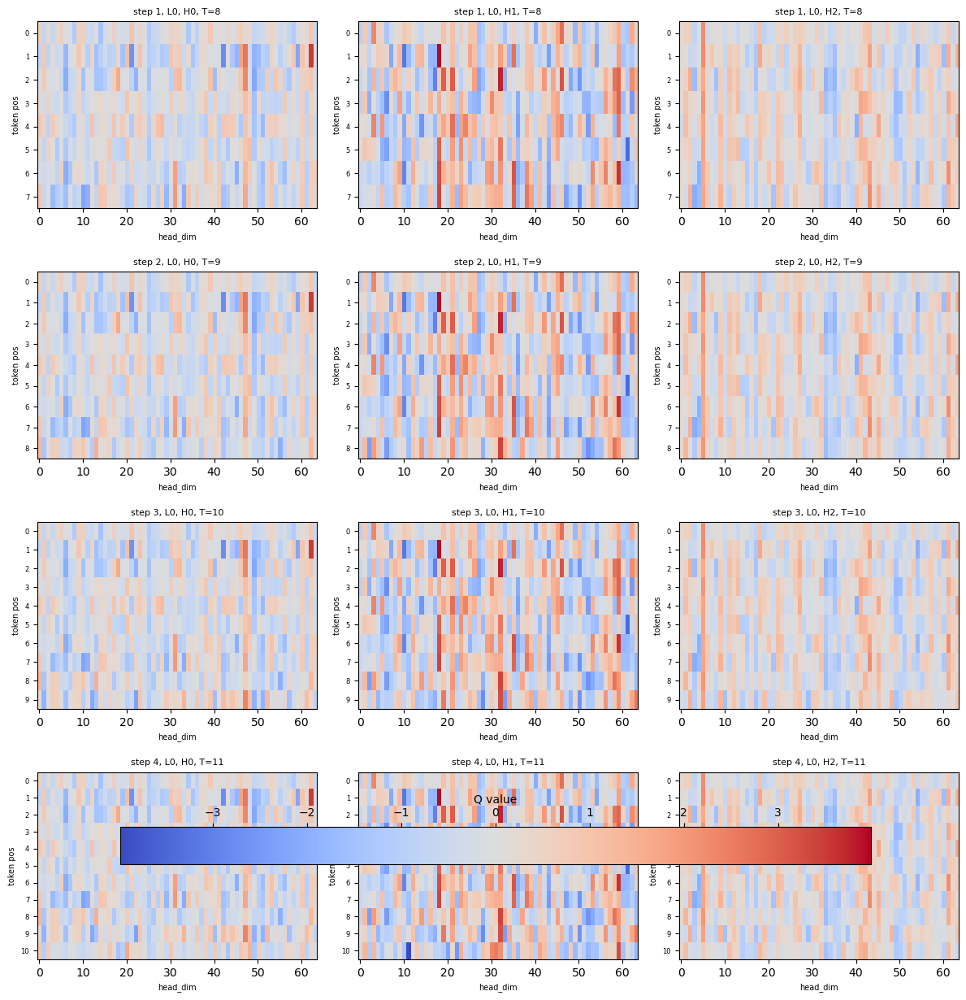

In [70]:
ENABLE_Q_EVOLUTION = True
Q_LAYER_TO_PLOT    = 0
Q_HEADS_TO_PLOT    = [0, 1, 2]  # несколько голов
MAX_STEPS_TO_PLOT  = 4          # например, только первые 4 шага

with torch.no_grad():
    with ctx:
        for k in range(num_samples):
            if ENABLE_Q_EVOLUTION:
                # Генерация с историей Q
                y, q_history = generate_with_q_history(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (с историей Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')

                # История Q для нескольких голов выбранного слоя
                plot_q_evolution_multiheads(
                    q_history,
                    layer_idx=Q_LAYER_TO_PLOT,
                    heads=Q_HEADS_TO_PLOT,
                    max_steps=MAX_STEPS_TO_PLOT,
                )

            else:
                # Обычная генерация без истории Q
                y = generate(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (без истории Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\458560872.py:185: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


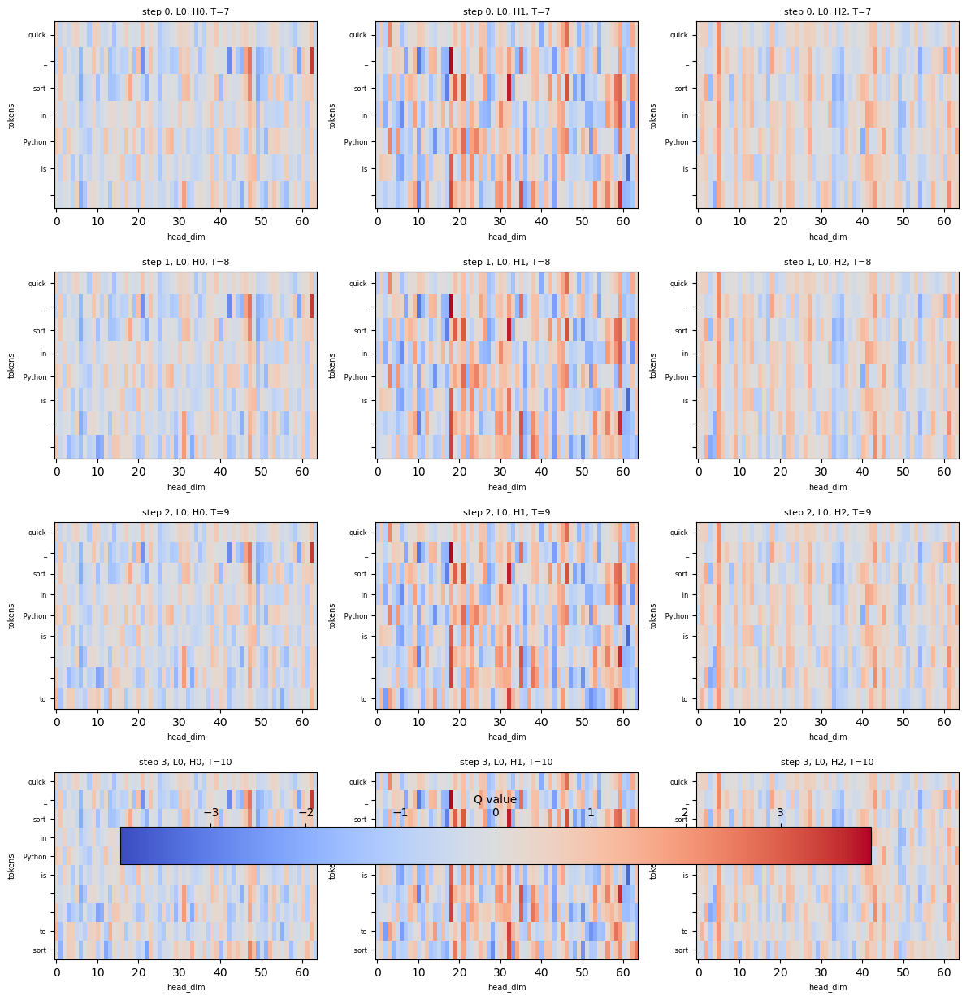

In [71]:
prompt_len = x.size(1)              # длина промпта L0
full_ids   = y[0].tolist()          # все токены: промпт + сгенерированные
gen_ids    = full_ids[prompt_len:]  # только сгенерированные токены
token_labels = [decode([tid]) for tid in gen_ids]

prompt_ids = x[0].tolist()
full_ids   = y[0].tolist()
gen_ids    = full_ids[len(prompt_ids):]

plot_q_evolution_multiheads(
    q_history,
    layer_idx=Q_LAYER_TO_PLOT,
    heads=Q_HEADS_TO_PLOT,
    max_steps=MAX_STEPS_TO_PLOT,
    skip_prompt=False,  # если хочешь видеть и чистый промпт (step=0)
    token_ids_prompt=prompt_ids,
    token_ids_generated=gen_ids,
    decode_fn=decode,   # та же функция, что ты уже используешь
)

quick_sort in Python is  to sort the data in a column by its
---------------


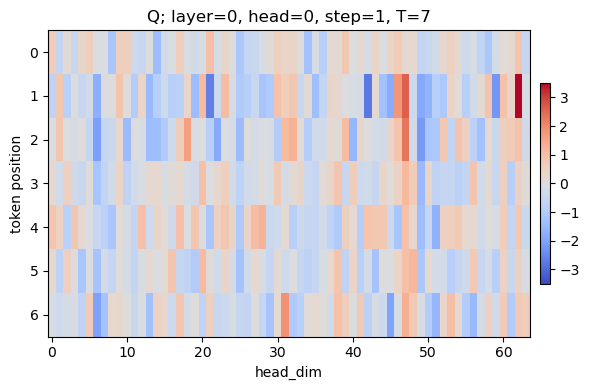

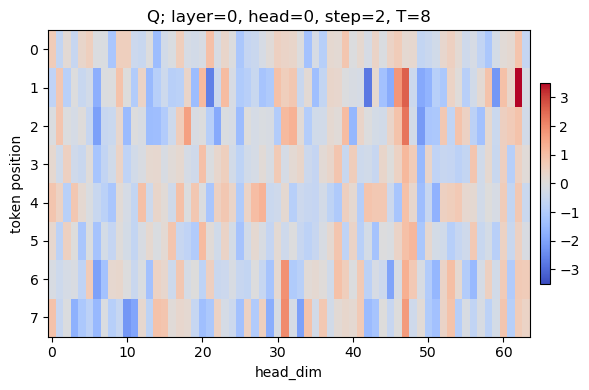

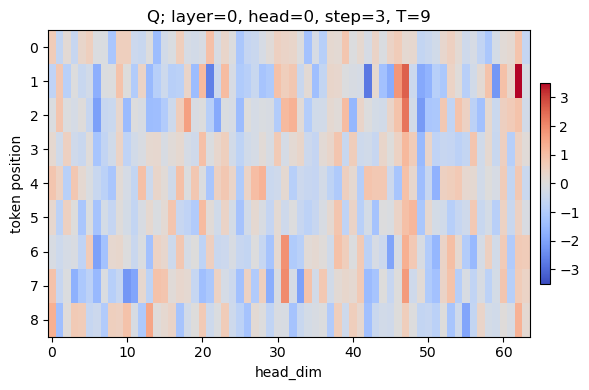

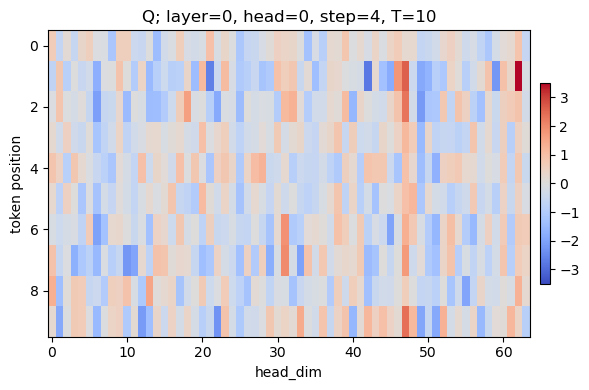

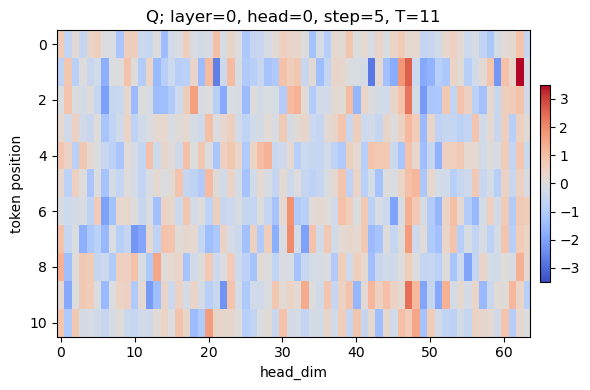

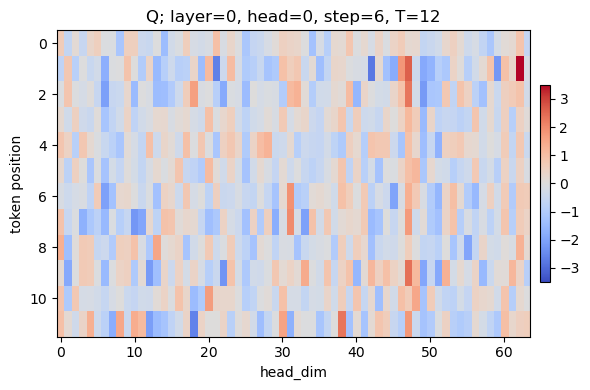

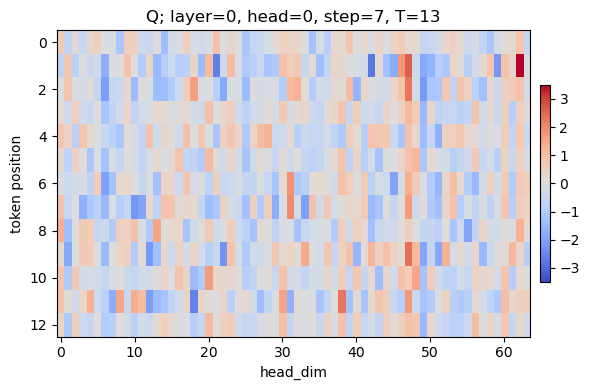

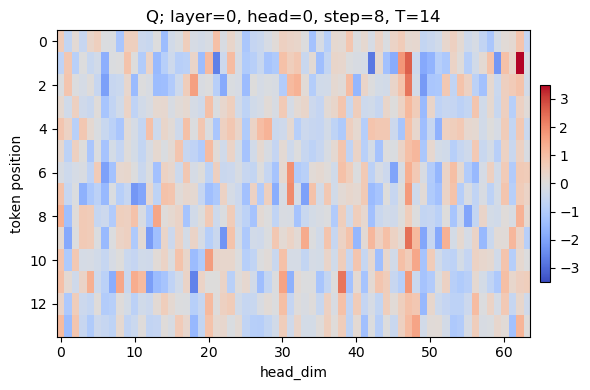

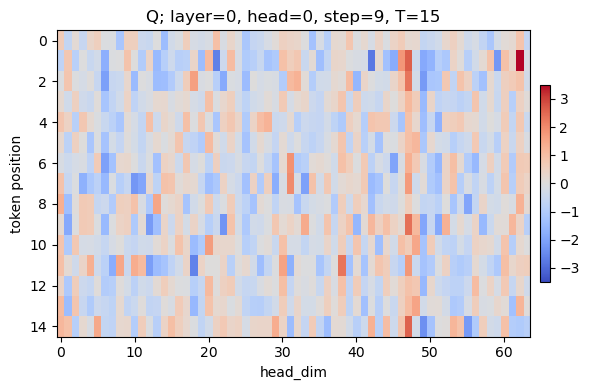

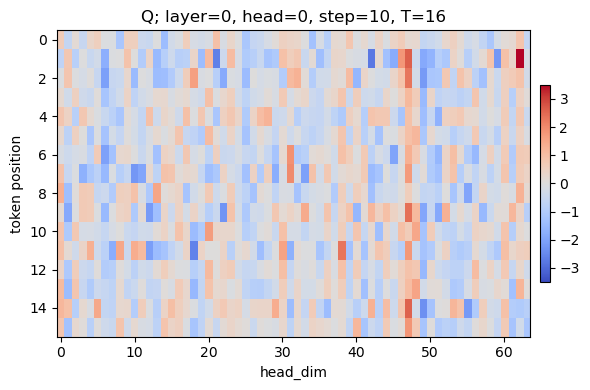

In [72]:
ENABLE_Q_EVOLUTION = False

with torch.no_grad():
    with ctx:
        # допустим, смотрим только один пример
        y, q_history = generate_with_q_history(
            model,
            idx=x,
            max_new_tokens=max_new_tokens,
            temperature=temperature,
            top_k=top_k,
        )
        print(decode(y[0].tolist()))
        print('---------------')

        # А теперь — эволюция Q для, скажем, слоя 0, головы 0
        plot_q_evolution(q_history, layer_idx=0, head_idx=0)


quick_sort in Python is  a function that takes a list of strings and
---------------


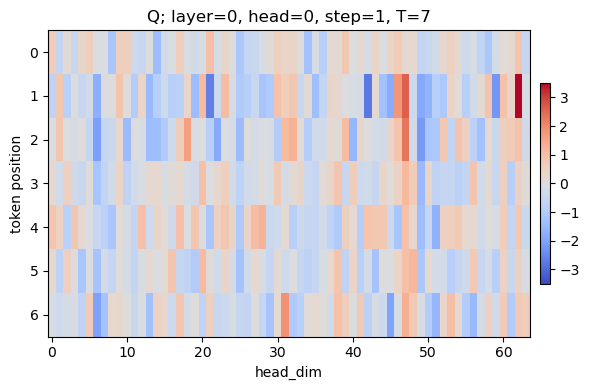

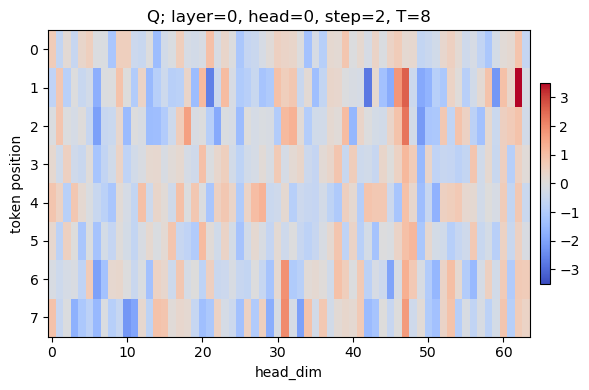

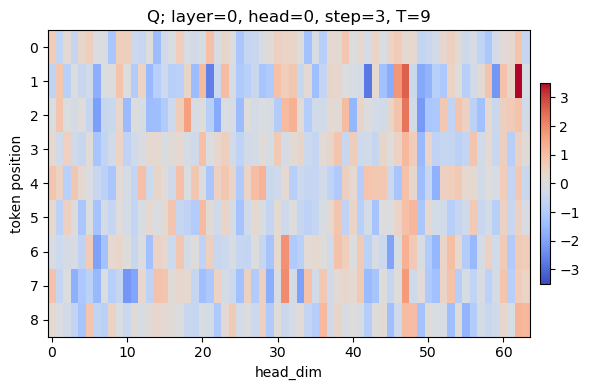

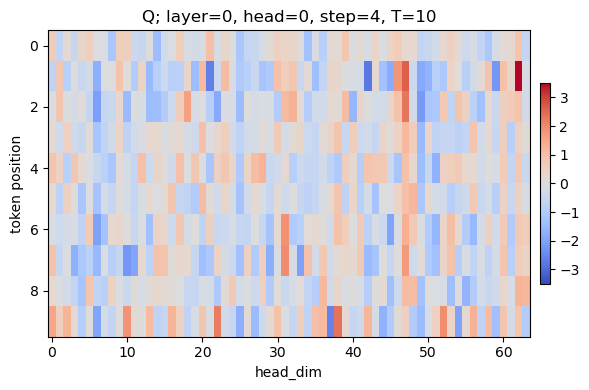

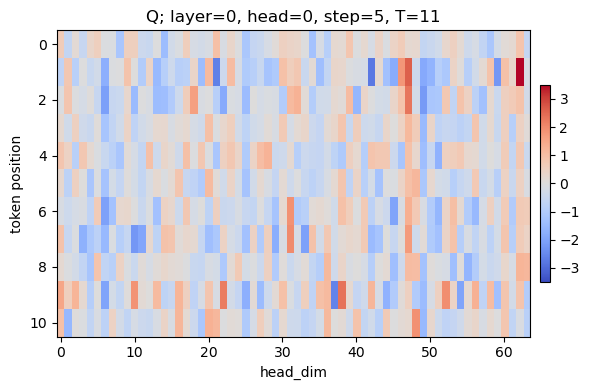

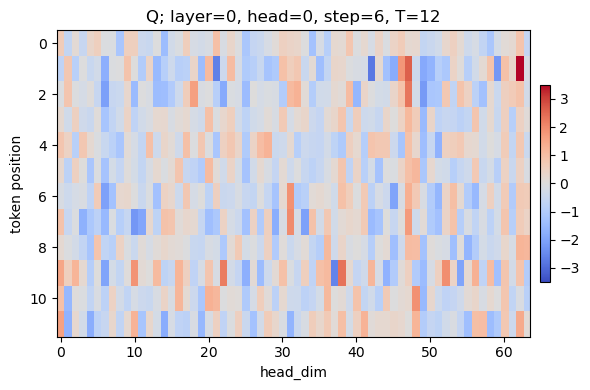

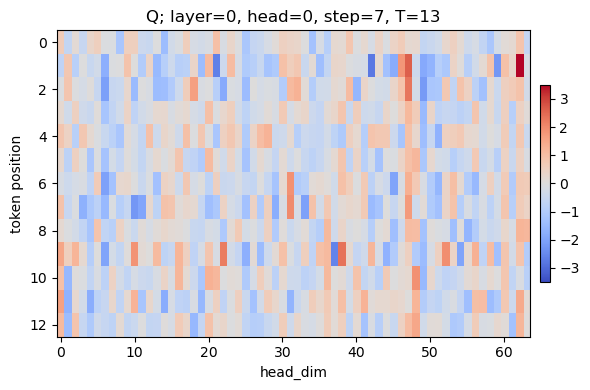

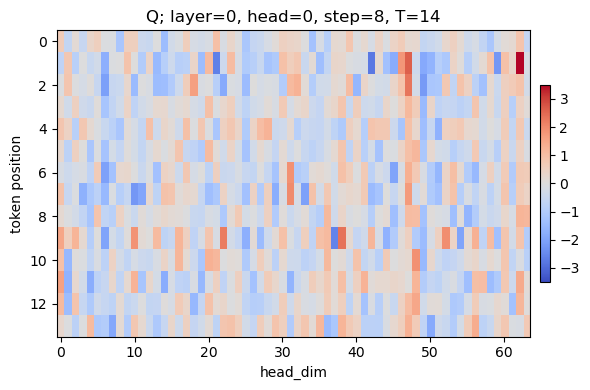

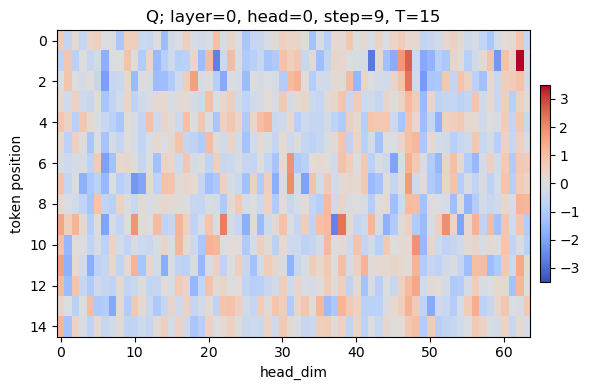

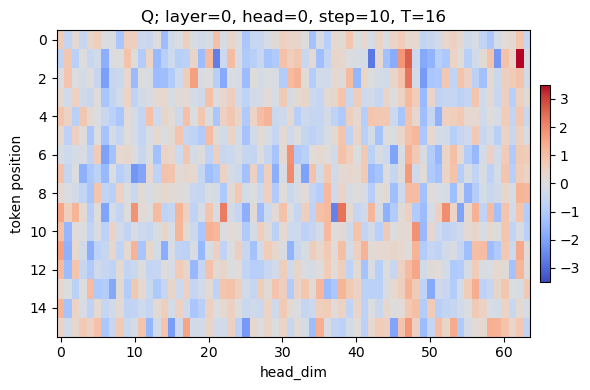

In [73]:
ENABLE_Q_EVOLUTION = False

with torch.no_grad():
    with ctx:
        # допустим, смотрим только один пример
        y, q_history = generate_with_q_history(
            model,
            idx=x,
            max_new_tokens=max_new_tokens,
            temperature=temperature,
            top_k=top_k,
        )
        print(decode(y[0].tolist()))
        print('---------------')

        # А теперь — эволюция Q для, скажем, слоя 0, головы 0
        plot_q_evolution(q_history, layer_idx=0, head_idx=0)


=== sample 1 (с историей Q) ===
quick_sort in Python is  a simple way to sort by the number of
---------------


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\458560872.py:185: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


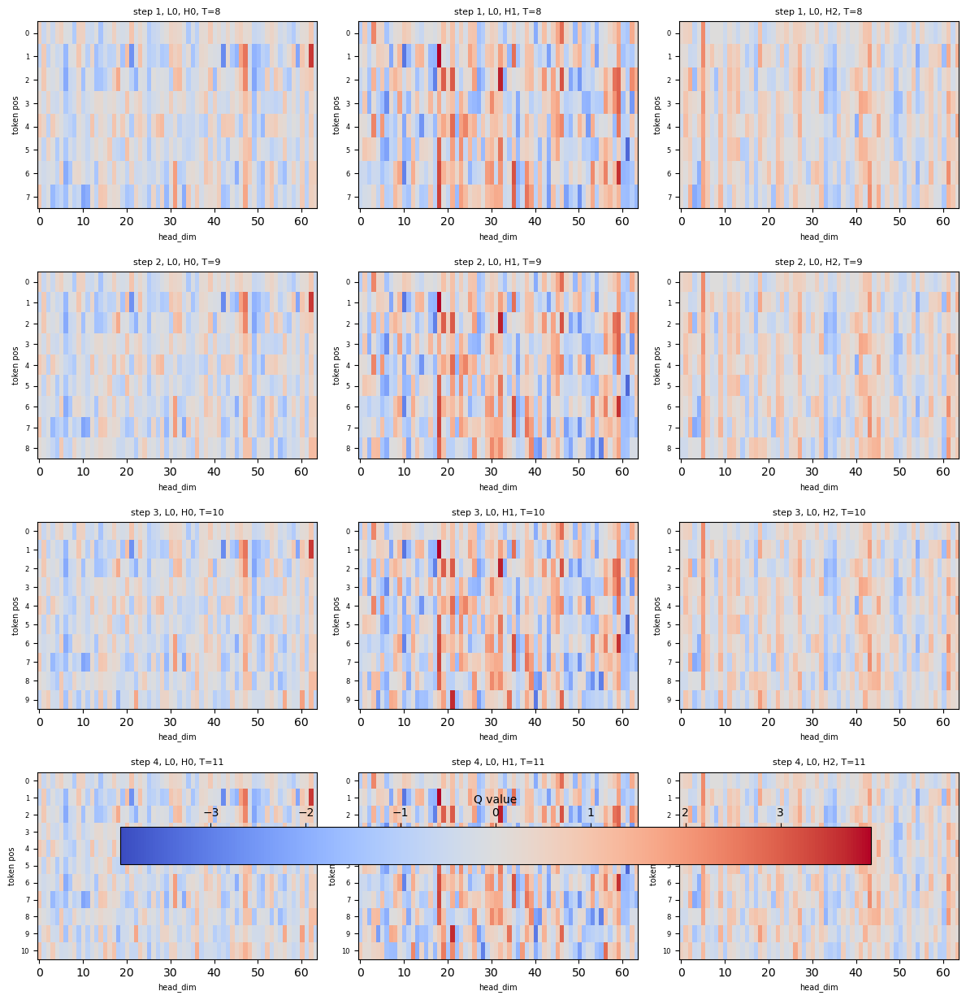

In [74]:
ENABLE_Q_EVOLUTION = True
Q_LAYER_TO_PLOT    = 0
Q_HEADS_TO_PLOT    = [0, 1, 2]  # несколько голов
MAX_STEPS_TO_PLOT  = 4          # например, только первые 4 шага

with torch.no_grad():
    with ctx:
        for k in range(num_samples):
            if ENABLE_Q_EVOLUTION:
                # Генерация с историей Q
                y, q_history = generate_with_q_history(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (с историей Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')

                # История Q для нескольких голов выбранного слоя
                plot_q_evolution_multiheads(
                    q_history,
                    layer_idx=Q_LAYER_TO_PLOT,
                    heads=Q_HEADS_TO_PLOT,
                    max_steps=MAX_STEPS_TO_PLOT,
                )

            else:
                # Обычная генерация без истории Q
                y = generate(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (без истории Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\458560872.py:185: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


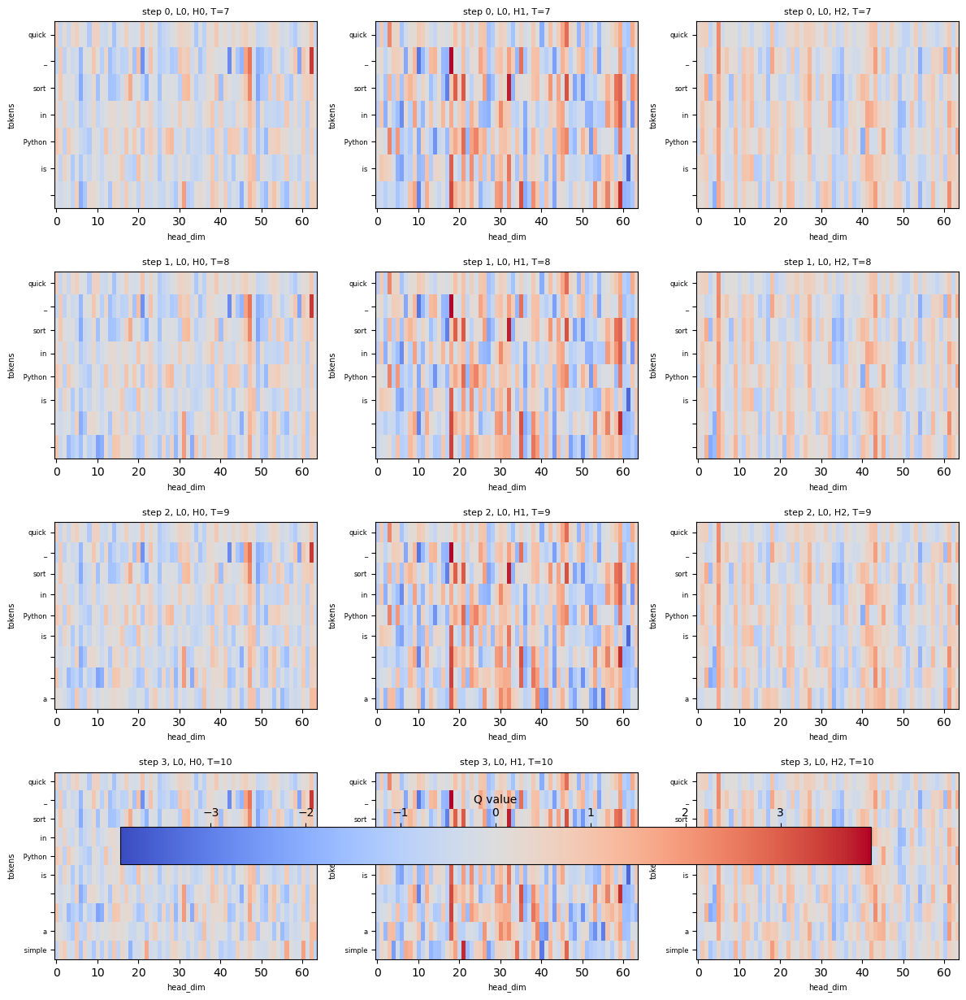

In [75]:
prompt_len = x.size(1)              # длина промпта L0
full_ids   = y[0].tolist()          # все токены: промпт + сгенерированные
gen_ids    = full_ids[prompt_len:]  # только сгенерированные токены
token_labels = [decode([tid]) for tid in gen_ids]

prompt_ids = x[0].tolist()
full_ids   = y[0].tolist()
gen_ids    = full_ids[len(prompt_ids):]

plot_q_evolution_multiheads(
    q_history,
    layer_idx=Q_LAYER_TO_PLOT,
    heads=Q_HEADS_TO_PLOT,
    max_steps=MAX_STEPS_TO_PLOT,
    skip_prompt=False,  # если хочешь видеть и чистый промпт (step=0)
    token_ids_prompt=prompt_ids,
    token_ids_generated=gen_ids,
    decode_fn=decode,   # та же функция, что ты уже используешь
)

## 3.3.Эти проверочные блоки, если imshow не работает. 
Сейчас не нужны, оставим на всякий случай

In [76]:
# Это просто проврочный блок, чтобы понять, что матрица формируется и ее можно показать
q = attn.last_q  # тензор формы (B, nh, T, hs)
print("Q shape:", q.shape)
print("Q[0,0] shape:", q[0, 0].shape)  # одна голова, один батч — форма (T, hs)
print("Q[0,0][:2]:", q[0, 0][:2])  # первые две строки, чтобы не ронять ядро

Q shape: torch.Size([1, 12, 16, 64])
Q[0,0] shape: torch.Size([16, 64])
Q[0,0][:2]: tensor([[ 1.5527e-01, -3.4375e-01,  2.2949e-01, -2.7734e-01, -3.4375e-01,
         -2.8906e-01,  4.9805e-02, -3.6621e-02, -1.0742e-02,  1.4062e-01,
         -1.6113e-01, -4.0820e-01, -6.7188e-01, -9.2285e-02,  1.5918e-01,
         -1.8750e-01,  1.5625e-02, -5.6641e-02, -1.9336e-01, -2.8906e-01,
         -1.2500e-01, -3.1445e-01,  8.2031e-02,  9.6094e-01, -1.3867e-01,
         -1.8066e-01,  3.4570e-01,  3.8086e-02,  3.7109e-01,  8.9844e-02,
          4.6094e-01, -1.5820e-01,  3.0469e-01,  3.1250e-01, -2.3193e-03,
         -6.5918e-02, -1.3281e-01, -4.0039e-01, -5.3467e-02, -7.5195e-02,
          3.7695e-01, -6.2180e-04,  4.6680e-01, -1.7969e-01,  7.9102e-02,
         -3.3203e-01, -4.5508e-01, -6.3281e-01,  1.3086e-01,  7.7148e-02,
         -4.0234e-01, -3.4424e-02,  2.2754e-01,  5.7373e-02, -2.9688e-01,
         -1.0889e-01, -1.3672e-01, -7.3047e-01, -5.8594e-02,  2.1118e-02,
          5.3125e-01, -3.710

In [77]:
layer_idx = 0  # слой
attn = model.transformer.h[layer_idx].attn  # attention слой 0

# Достаём матрицу весов (3C × C)
W_cat = attn.c_attn.weight.detach().cpu()  # shape: (3C, C)

# Транспонируем, чтобы получить "человеческий" формат: (C, 3C)
W_cat = W_cat.T  # shape: (C, 3C)

# Получаем размерность C
C = attn.n_embd

# Разрезаем на 3 части: W_q, W_k, W_v
W_q = W_cat[:, :C]
W_k = W_cat[:, C:2*C]
W_v = W_cat[:, 2*C:]

# Показываем только форму и пару строк (без печати всей матрицы!)
print("W_q shape:", W_q.shape)
print("W_k shape:", W_k.shape)
print("W_v shape:", W_v.shape)

print("W_q[:2, :5] =\n", W_q[:2, :5])
print("W_k[:2, :5] =\n", W_k[:2, :5])
print("W_v[:2, :5] =\n", W_v[:2, :5])


W_q shape: torch.Size([768, 768])
W_k shape: torch.Size([768, 768])
W_v shape: torch.Size([768, 768])
W_q[:2, :5] =
 tensor([[-0.4738, -0.2614, -0.0978, -0.3499,  0.2243],
        [ 0.0874,  0.1473,  0.2387,  0.2884,  0.6491]])
W_k[:2, :5] =
 tensor([[ 0.3660,  0.0771,  0.2226,  0.0138, -0.0494],
        [-0.4380, -0.1446, -0.4717, -0.0253,  0.0490]])
W_v[:2, :5] =
 tensor([[ 0.1421,  0.0329, -0.0667,  0.0188, -0.0645],
        [ 0.0162, -0.0633, -0.0636,  0.0340, -0.0322]])


In [78]:
t3_itogo = tm.time()
print('при количестве создаваемых токенов ', max_new_tokens , 'и прогонов ', num_samples, 'весь неважный код код занял', round(t3_itogo - t2_itogo)//60,'минут', 
      round(t3_itogo - t2_itogo)%60,'секунд')

при количестве создаваемых токенов  10 и прогонов  1 весь неважный код код занял 0 минут 27 секунд


In [79]:
# run generation

ENABLE_Q_EVOLUTION = True   # или False, чтобы отключить
Q_LAYER_TO_PLOT   = 0       # какой слой смотреть
Q_HEAD_TO_PLOT    = 1       # какую голову в этом слое

print("печать промпта")
print(start_prompt)

print ("печать токенов")
with torch.no_grad():
    with ctx:
        for k in range(num_samples):
            if ENABLE_Q_EVOLUTION:
                # Генерация с сохранением истории Q
                y, q_history = generate_with_q_history(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (с эволюцией Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')

                

            else:
                # Обычная генерация без логирования Q
                y = generate(
                    model,
                    idx=x,
                    max_new_tokens=max_new_tokens,
                    temperature=temperature,
                    top_k=top_k,
                )
                print(f"=== sample {k+1} (без эволюции Q) ===")
                print(decode(y[0].tolist()))
                print('---------------')


печать промпта
quick_sort in Python is 
печать токенов
=== sample 1 (с эволюцией Q) ===
quick_sort in Python is  to sort the order of the items in the
---------------


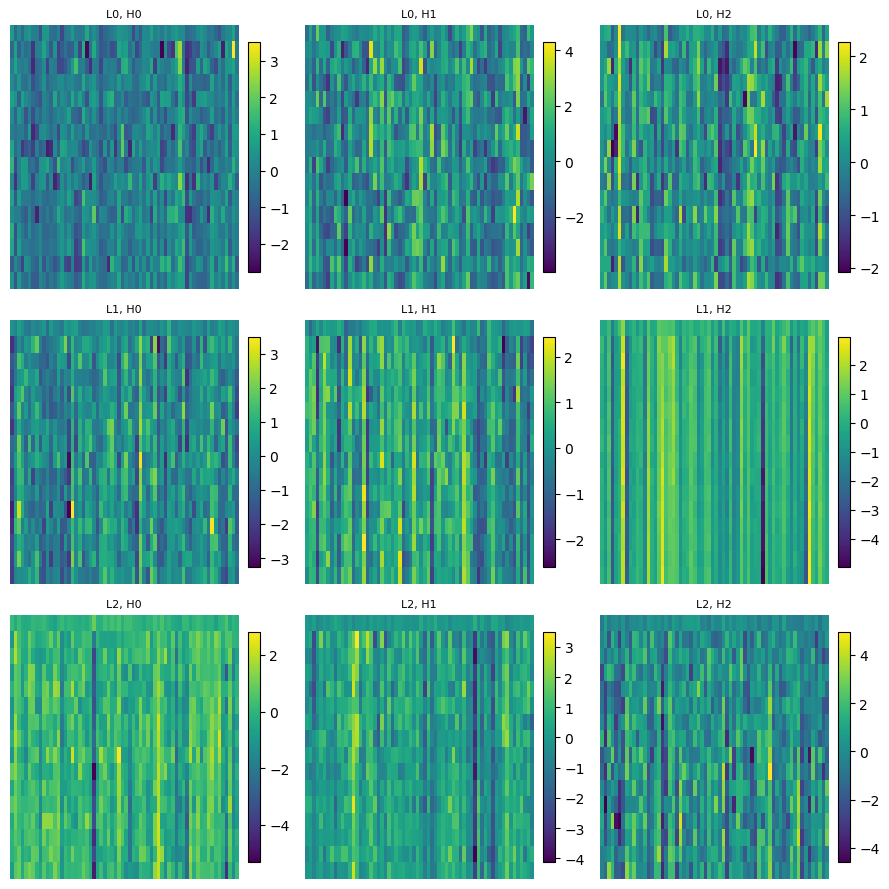

In [80]:
# In[36]:
ENABLE_Q_EVOLUTION = True

if ENABLE_Q_EVOLUTION:
    # а это уже печать динамических матриц для НЕСКОЛЬКИХ голов
    range_layer_idx = 3  # сколько слоёв посмотреть (с 0-го)
    num_head_idx    = 3  # сколько голов на каждый слой (с 0-й)

    fig, axes = plt.subplots(
        nrows=range_layer_idx,
        ncols=num_head_idx,
        figsize=(3 * num_head_idx, 3 * range_layer_idx)  # масштабируем по числу картинок
    )

    # если 1 строка или 1 столбец — привести axes к 2D
    if range_layer_idx == 1:
        axes = np.expand_dims(axes, axis=0)
    if num_head_idx == 1:
        axes = np.expand_dims(axes, axis=1)

    for layer_idx in range(range_layer_idx):
        attn = model.transformer.h[layer_idx].attn
        for head_idx in range(num_head_idx):
            q = attn.last_q[0, head_idx]  # (T, head_dim) для этой головы

            ax = axes[layer_idx, head_idx]
            im = ax.imshow(q, aspect='auto', interpolation='nearest')
            ax.set_title(f"L{layer_idx}, H{head_idx}", fontsize=8)
            ax.axis('off')  # убираем оси для компактности
            fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()


quick_sort in Python is ~~~

>>> from django.db
---------------


C:\Users\anhin\AppData\Local\Temp\ipykernel_15688\458560872.py:185: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


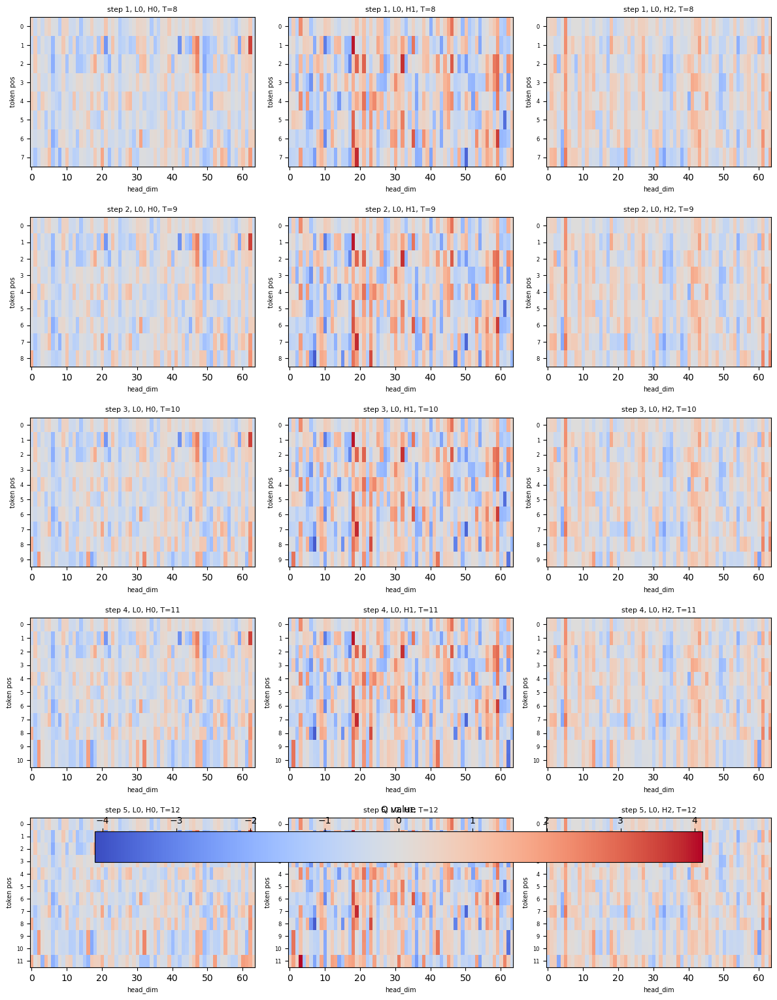

In [81]:
y, q_history = generate_with_q_history(
    model,
    idx=x,
    max_new_tokens=max_new_tokens,
    temperature=temperature,
    top_k=top_k,
)

print(decode(y[0].tolist()))
print("---------------")

plot_q_evolution_multiheads(
    q_history,
    layer_idx=0,
    heads=[0, 1, 2],     # несколько голов
    max_steps=5,         # не больше 5 шагов генерации
    skip_prompt=True,    # step=1 -> первый сгенерированный токен
)
